# Flats [Feb 2019] - Red array

This reduction includes the data taken before the FIFI-LS series in Feb-Mar 2019.

The method followed to obtain the flats is the following:

1. First, for each spaxel $i$, I obtain a median spectrum: $f_i (\lambda) $ using all the spexels $i, j$ with $j=0,15$.

2. Then, I obtain a median spectrum from all the spaxels  $f (\lambda)$ assuming a series of constant factors to scale the different spaxel spectra to a median spectrum. I call these factors spatial flats ($flat_{spat; i}$).

3. At this point, I go back to the original spexels and obtain the spectral relative response (or spectral flat)
using the ratios:   $flat_{spec; i, j} (\lambda) = f (\lambda) / f_{i, j} (\lambda)$.

4. At the end, I merge the spaxel spectral flat and spexels spectral flat to obtain a merged one.

In this way, I obtain a cube of spectral responses and an array of spatial flats.
The spectral responses should be computable from laboratory values. The spatial flats depend on the illumination of 
the array and, in principle, can vary between laboratory and sky.
Also, I obtain a spatial flat for each calibration series and only one spectral flat common to all the series.


In [1]:
# Used if in non-interactive mode to skip tests
Test = False

# Red 

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
from fifipy.io import readSlopeFits
from fifipy.spectra import computeMedianSpatialSpectra, computeSplineFits
import numpy as np

# Read slopes and compute median spectra
caldir1 = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_08_2018/'
files1 = ['D130R_1.fits','D130R_2.fits','D105R_1.fits','D105R_2.fits']
date1 = ['8/18'] * len(files1)
dichroic1 = [130,130,105,105]
caldir2 = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2018/'
files2 =  ['D105R_1.fits','D105R_2.fits','D105R_3.fits','D105R_5.fits',
           'D105R_6.fits','D130R_1.fits','D130R_2.fits','D130R_3.fits']
date2 = ['2/18'] * len(files2)
dichroic2 = [105,105,105,105,105,130,130,130]
caldir3 = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_03_2017/'
files3 =  ['D105R_1.fits','D130R_1.fits']
dichroic3 = [105,130]
date3 = ['3/17'] * len(files3)
caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_10_2018/'
files = ['D105R.fits','D105R_1.fits','D105R_2.fits','D130R.fits','D130R_1.fits']
dichroic = [105,105,105,130,130]
date = ['10/18'] * len(files)
caldir4 =  '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/calsource_flat_02_2019/'
files4 = ['D105R_1.fits','D105R_2.fits','D130R_1.fits','D130R_2.fits']
date4 = ['2/19'] * len(files4)
dichroic4 = [105,105,130,130]

# All
filess = [files,files1,files2,files3,files4]
caldirs = [caldir,caldir1,caldir2,caldir3,caldir4]
signs = [1,-1,-1,1,-1]
dichroics = np.concatenate([dichroic, dichroic1, dichroic2, dichroic3, dichroic4])
dates = np.concatenate([date, date1, date2, date3, date4])

wmin = 100
wmax = 200
for files, caldir in zip(filess, caldirs):
    for file in files:
        g, w, dw, s = readSlopeFits(caldir, file)
        wmin_ = np.nanmin(w); wmax_ = np.nanmax(w)
        if wmin_ < wmin: wmin = wmin_
        if wmax_ > wmax: wmax = wmax_
    
waves = []
spectra = []
for files, caldir, sign in zip(filess, caldirs, signs):
    for file in files:
        g, w, dw, s = readSlopeFits(caldir, file)
        wave, spectrum = computeSplineFits(w,dw,s,'R', wmin, wmax)
        waves.append(wave)
        spectra.append(sign*spectrum)
 
spectra = np.array(spectra)
print(np.shape(spectra))

spatspectra = []
for spectrum in spectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)

spatspectra = np.array(spatspectra)

(23, 400, 768)


/Users/dfadda/Python/fifipy/fifipy/spectra.py:87: RuntimeWarning: Mean of empty slice
  mspec = np.nanmean(spec[m],axis=0)
/Users/dfadda/anaconda3/lib/python3.6/site-packages/numpy/lib/function_base.py:3405: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:80: RuntimeWarning: Mean of empty slice
  d.append(np.nanmean(np.array(r)))
/Users/dfadda/Python/fifipy/fifipy/spectra.py:84: RuntimeWarning: invalid value encountered in less
  m = np.abs(d-med) < 3*mad


Reading previous flats produced by Christian Fischer

In [3]:
# Grab Christian's flats
chrisdir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/Christian/flats/'
wch = np.arange(119,206,1)
nw_ = np.size(wch)
f105 = np.ones((nw_,25,16))
f130 = np.ones((nw_,25,16))
ff105 = np.ones((nw_,25))
ff130 = np.ones((nw_,25))

nw = range(nw_)
for w,i in zip(wch,nw):
    wstr = str(w)
    try:
        f = np.loadtxt(chrisdir+wstr+'/flat.txt')
        f105[i,:,:] = f
        f = np.loadtxt(chrisdir+wstr+'/flatfield.txt')
        ff105[i,:] = f
    except:
        pass
    try:
        f = np.loadtxt(chrisdir+wstr+'_D130/flat.txt')
        f130[i,:,:] = f
        f = np.loadtxt(chrisdir+wstr+'_D130/flatfield.txt')
        ff130[i,:] = f
    except:
        pass

## Step 1

Find relative factors for different series.


/Users/dfadda/Python/fifipy/fifipy/stats.py:18: RuntimeWarning: invalid value encountered in greater_equal
  mask = (np.abs(u) >= 1)
/Users/dfadda/Python/fifipy/fifipy/stats.py:21: RuntimeWarning: invalid value encountered in true_divide
  return M.squeeze() + np.nansum(d * u, axis=axis) / np.nansum(u, axis=axis)


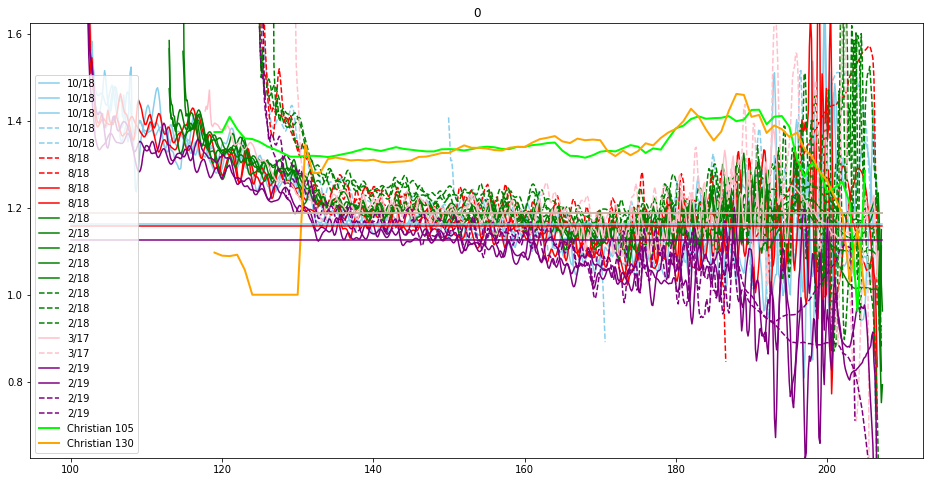

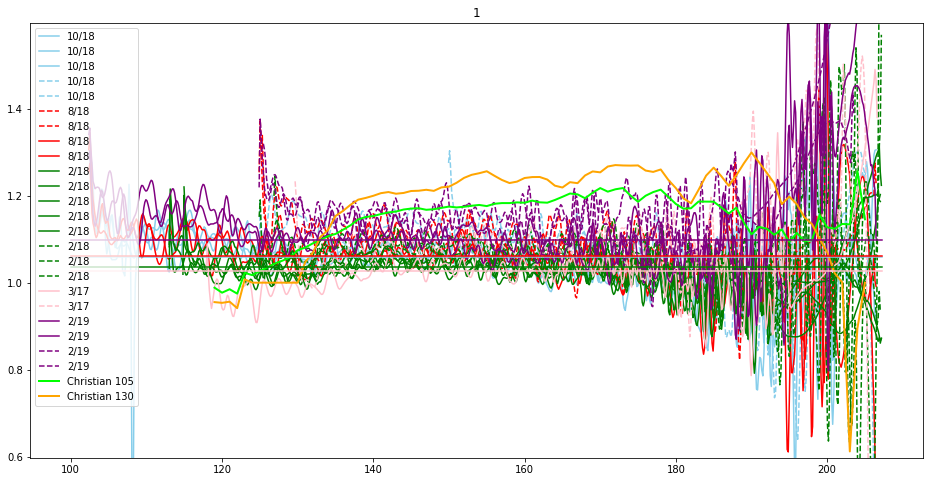

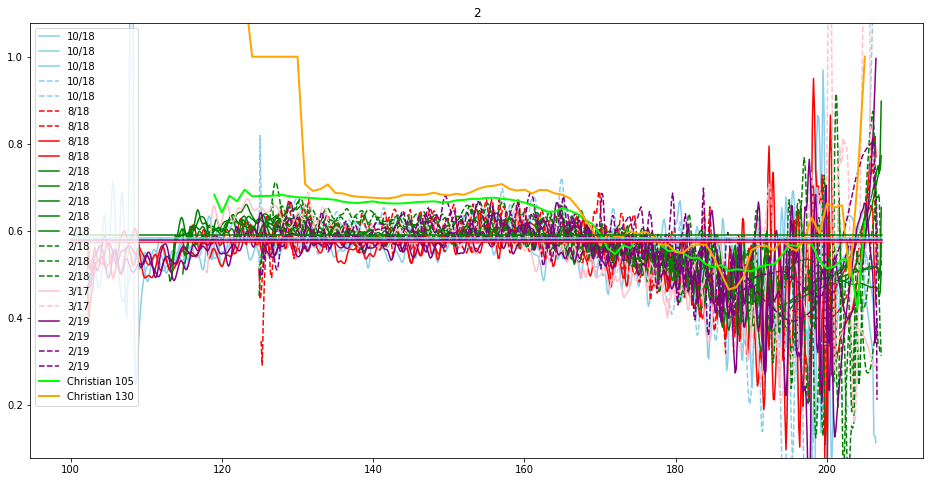

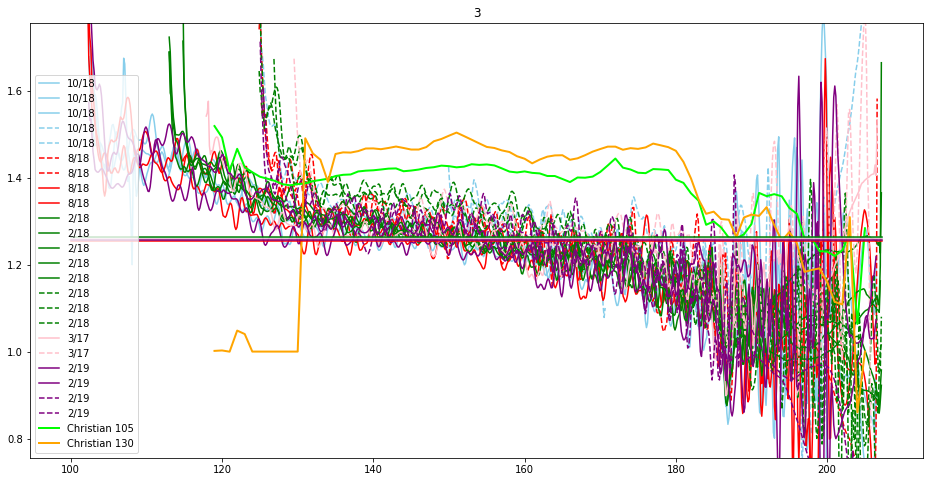

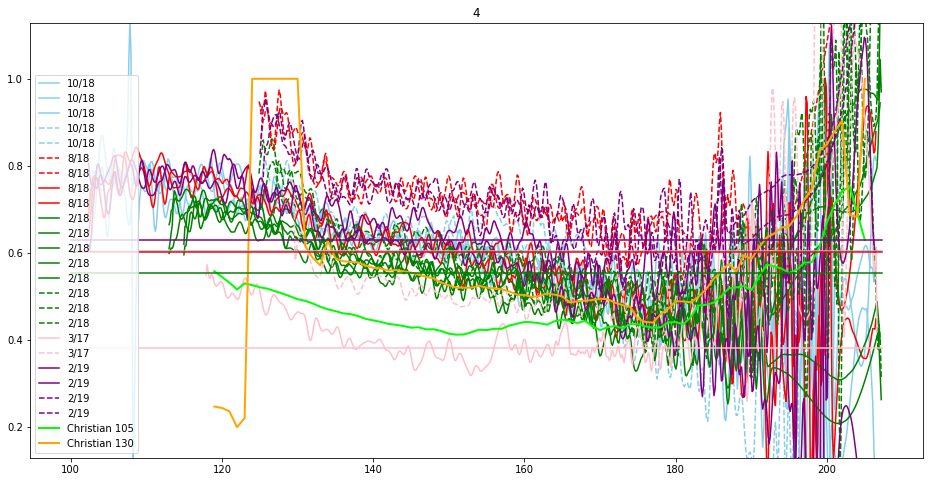

...

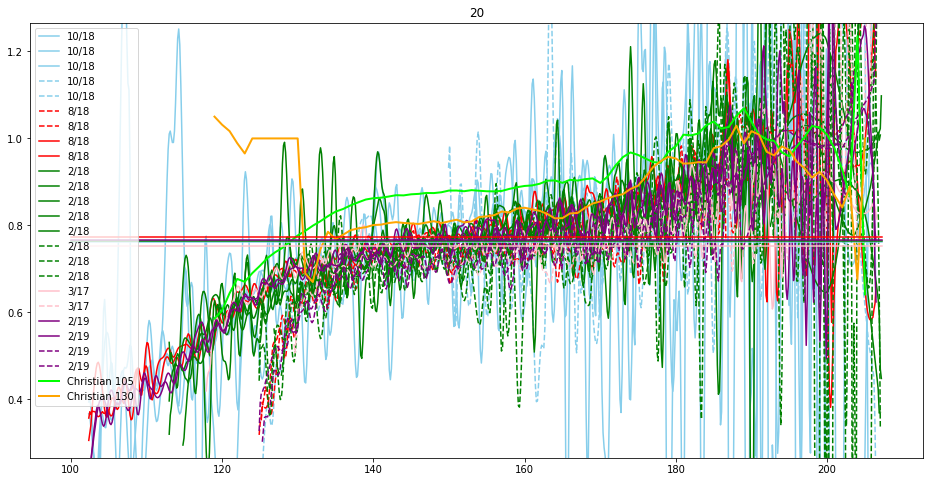

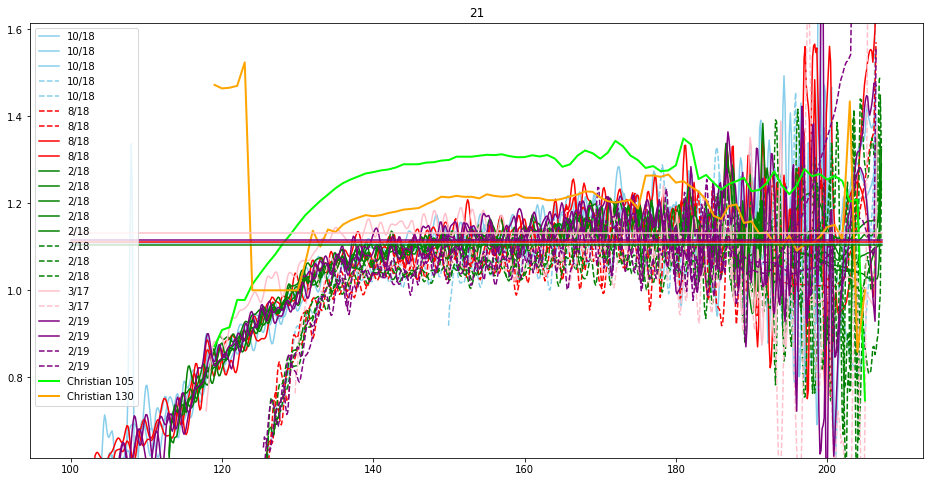

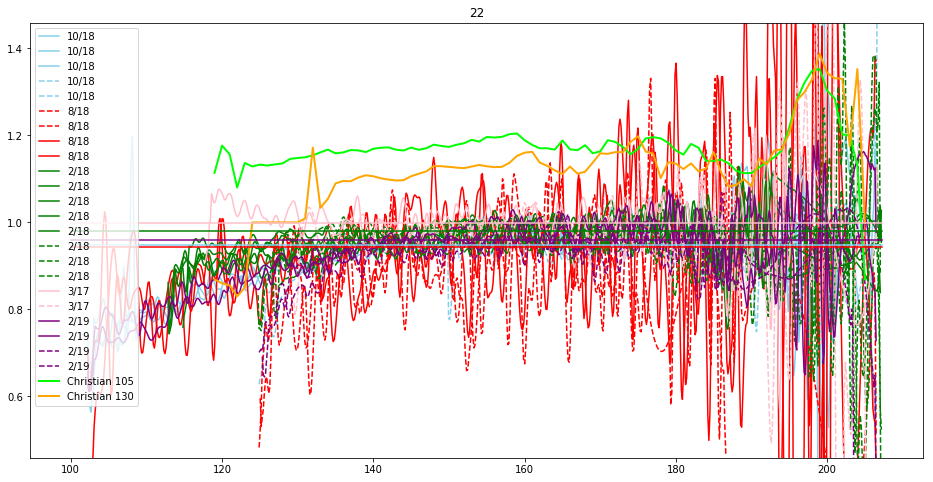

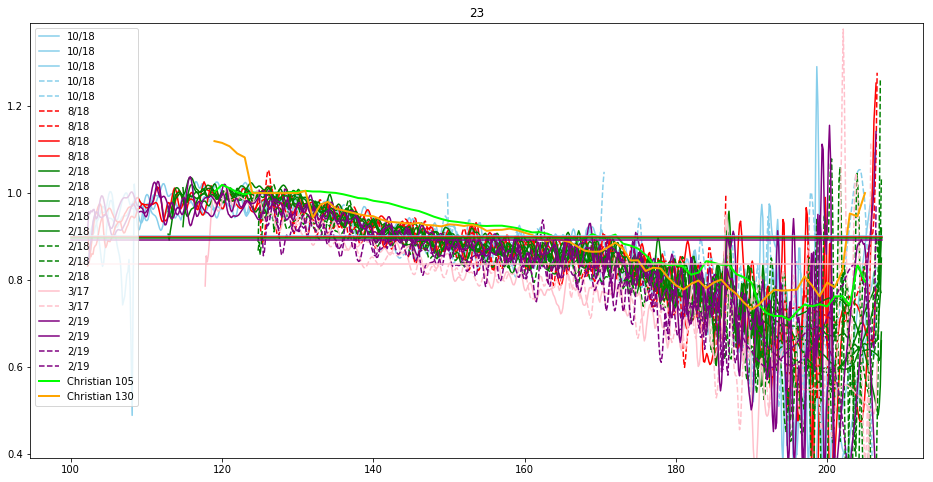

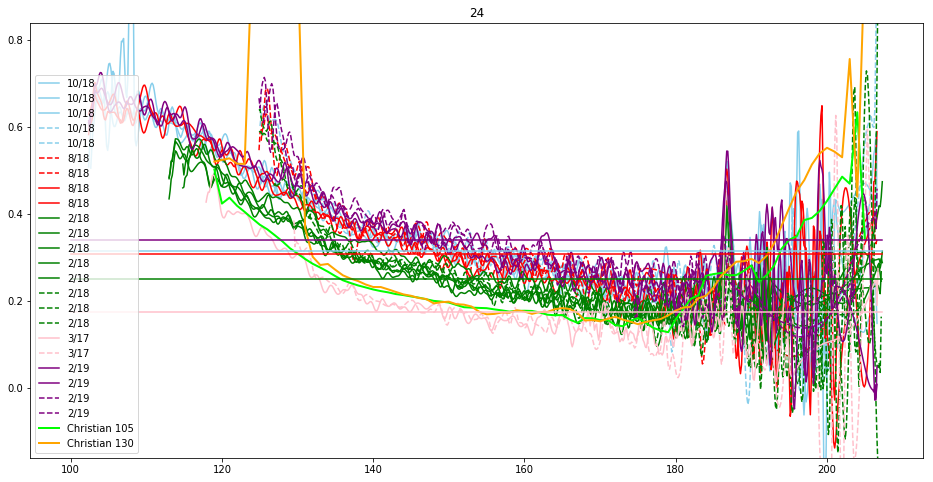

In [4]:
# Plot of  median spaxel spectra over median total spectra (except bad illuminated column)
from fifipy.stats import biweightLocation

s1 = np.ones(25)
s2 = np.ones(25)
s3 = np.ones(25)
s4 = np.ones(25)
s5 = np.ones(25)

mask = [0,1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
#mask = range(25)
for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    m1 = []
    m2 = []
    m3 = []
    m4 = []
    m5 = []
    for w, s, d, dic in zip(waves, spatspectra, dates, dichroics):
        meds = biweightLocation(s[mask,:], axis = 0)
        idw = (w > 130) & (w < 170)
        m = biweightLocation(s[ispax,idw]/meds[idw])    
        if d == '10/18':
            color='skyblue'
            if dic == 105:
                m1.append(m)
        elif d == '8/18':
            color='red'
            if dic == 105:
                m2.append(m)
        elif d == '2/18':
            color='green'
            if dic == 105:
                m3.append(m)
        elif d == '3/17':
            color='pink'
            if dic == 105:
                m4.append(m)
        elif d == '2/19':
            color='purple'
            if dic == 105:
                m5.append(m)
        else:
            color='black'
        if dic == 105:
            line = '-'
        else:
            line = '--'
        #if dic == 105:
        ax.plot(w, s[ispax,:]/meds, line, label = d, color=color)
    ax.plot(wch, ff105[:,ispax],color='lime',label='Christian 105',linewidth=2)
    ax.plot(wch, ff130[:,ispax],color='orange',label='Christian 130',linewidth=2)
    ax.legend()
    ax.set_title(str(ispax))
    for m, col, s in zip([m1,m2,m3,m4,m5],['skyblue','red','green','pink','purple'],[s1,s2,s3,s4,s5]):
        m = np.array(m)
        medm = np.nanmedian(m)
        ax.set_ylim(medm-0.5, medm+0.5)
        ax.plot(w, np.full(len(w), medm), color=col)
        s[ispax] = medm
    plt.show()


## Step 2

Find relative response (to the median spectrum) for each spaxel normalized to the flats found in step 1.
In this way we can use all the data. 

The two dichroics will be treated separately.

/Users/dfadda/Python/fifipy/fifipy/stats.py:16: RuntimeWarning: invalid value encountered in true_divide
  u = d / (c * mad)


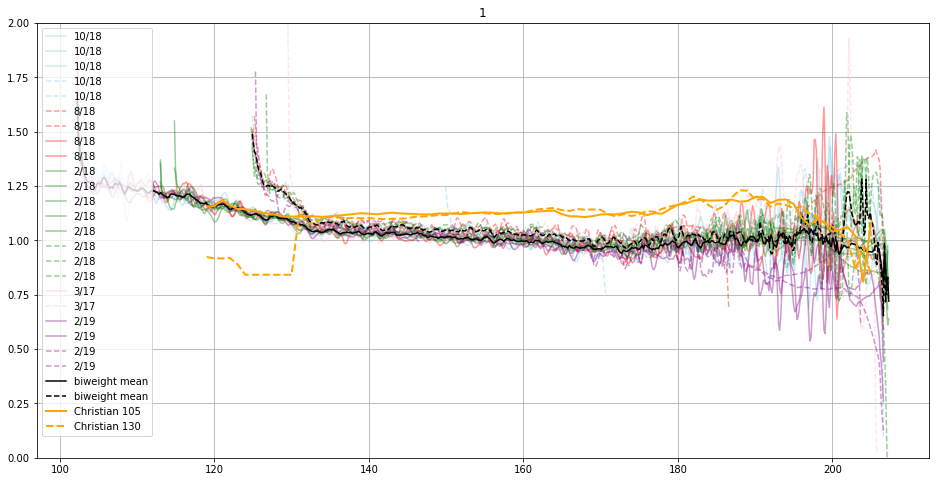

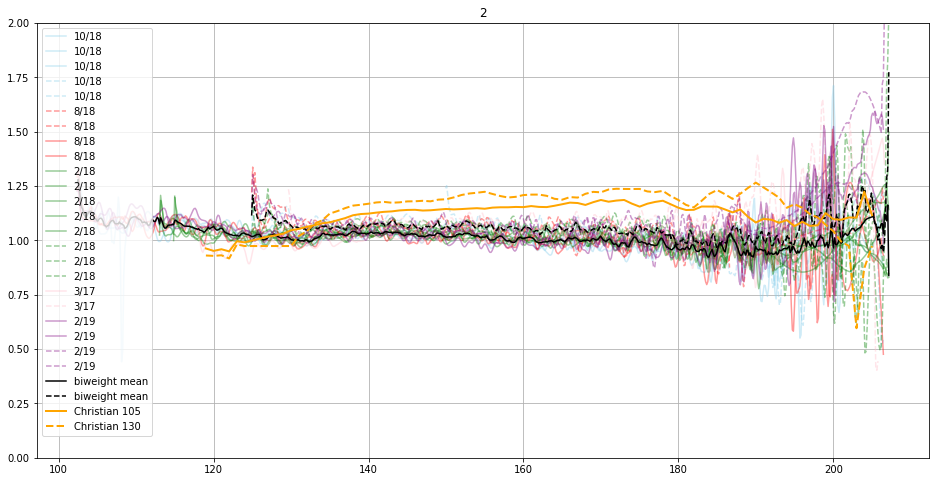

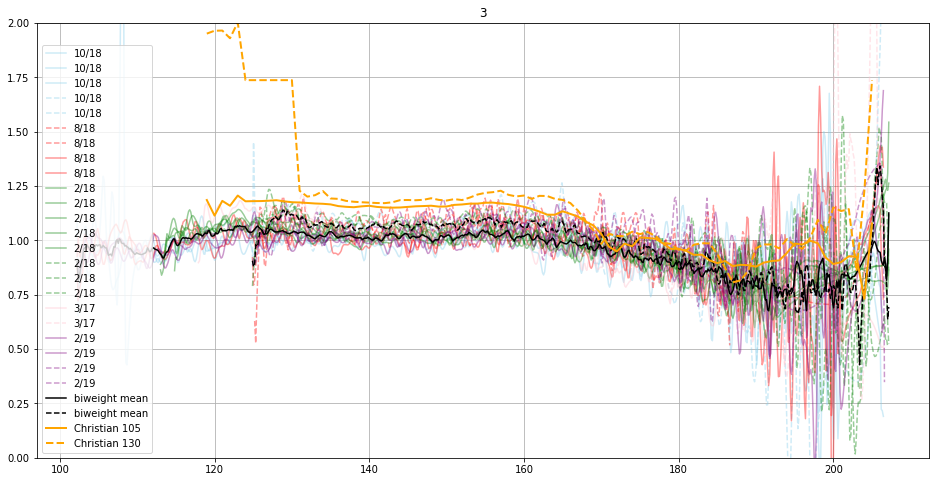

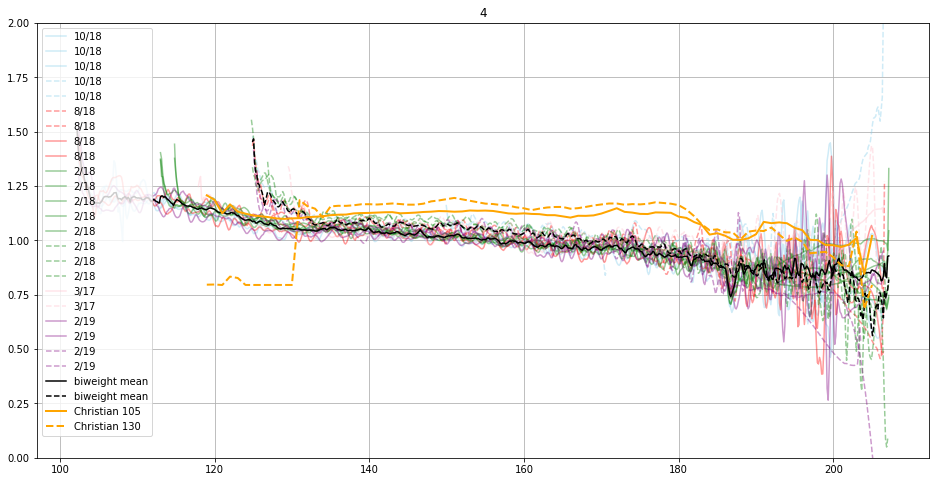

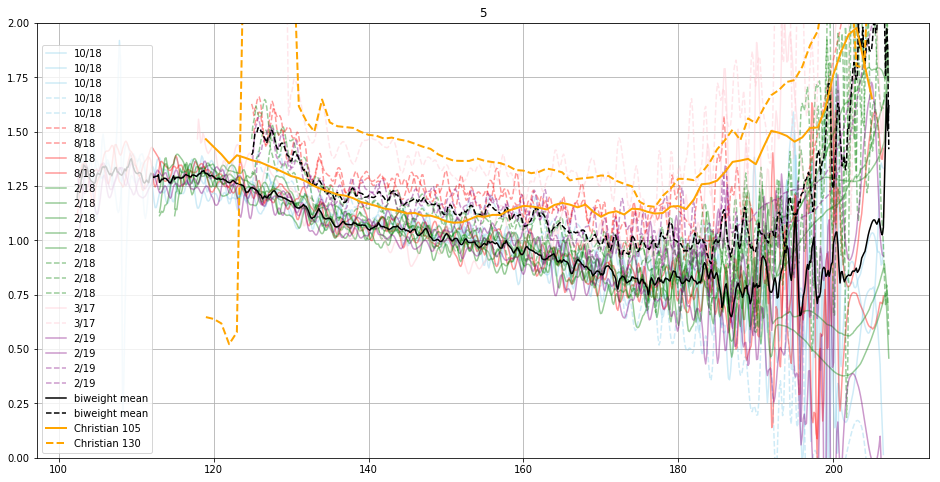

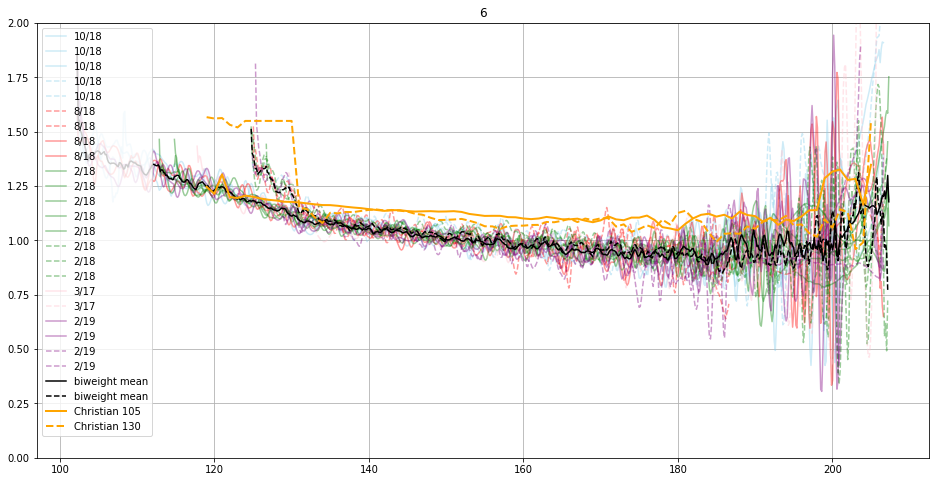

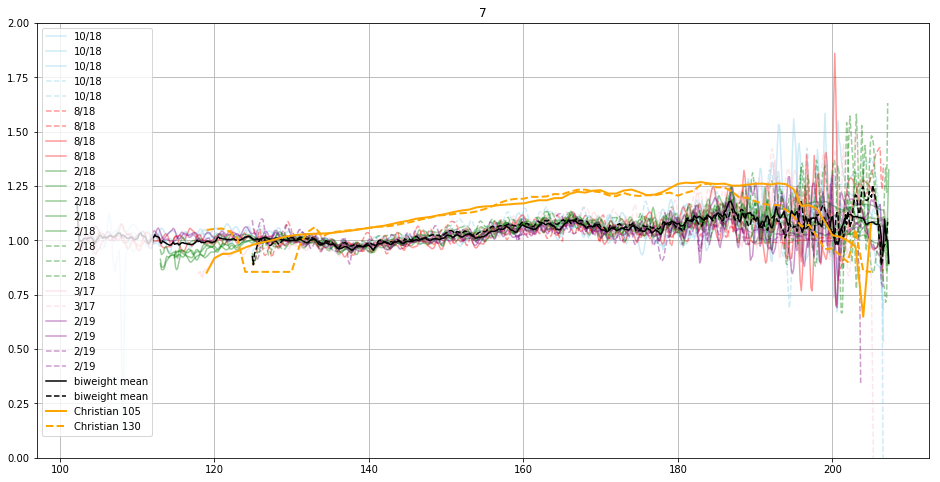

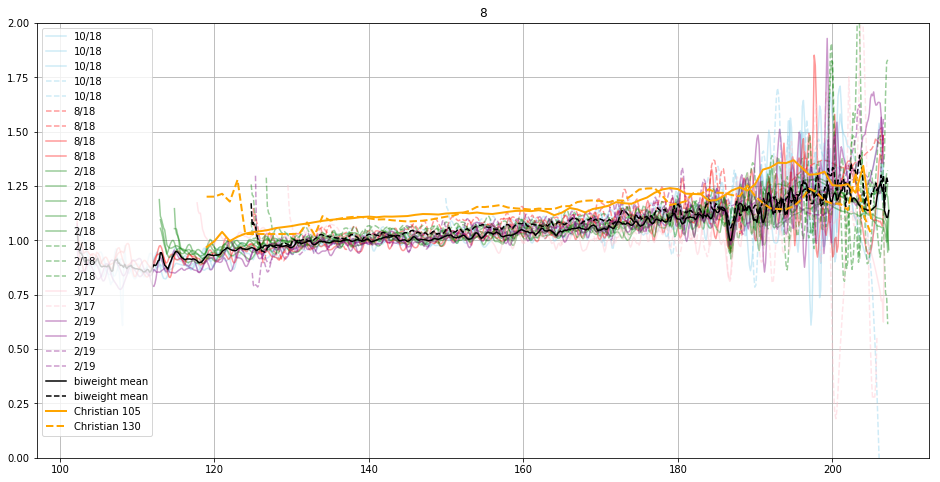

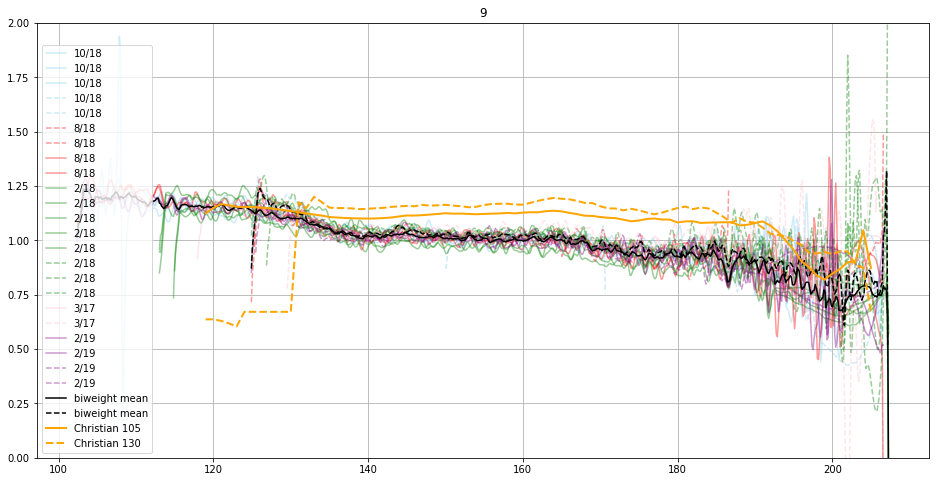

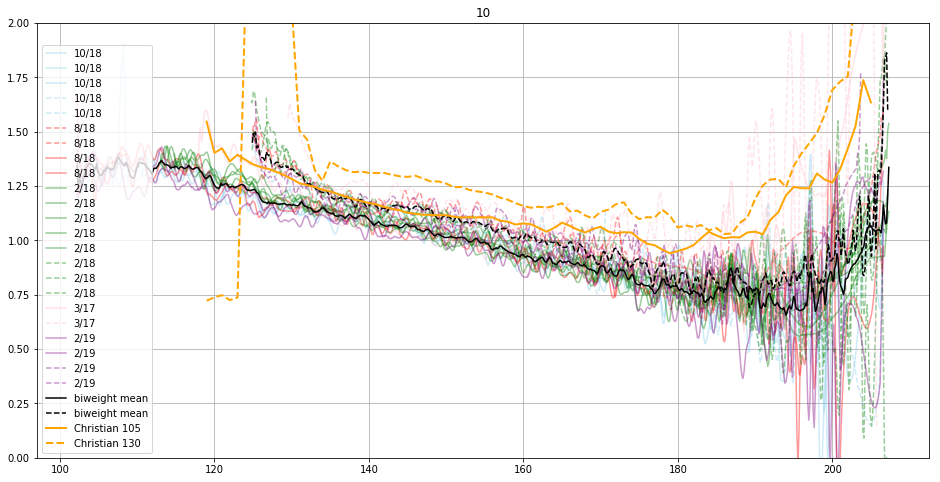

/Users/dfadda/Python/fifipy/fifipy/stats.py:16: RuntimeWarning: divide by zero encountered in true_divide
  u = d / (c * mad)


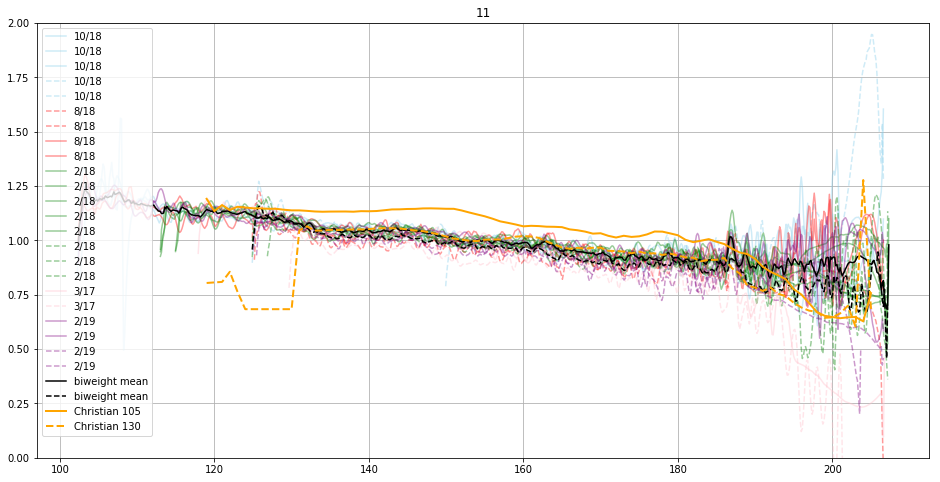

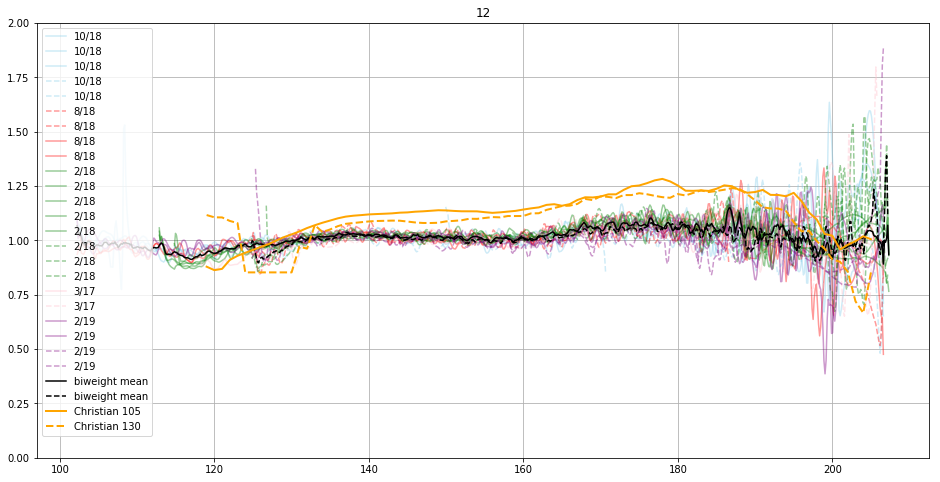

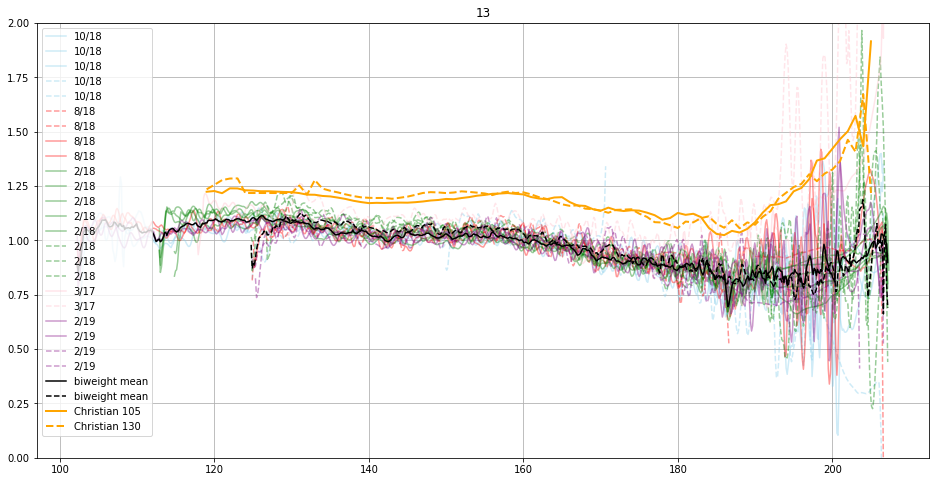

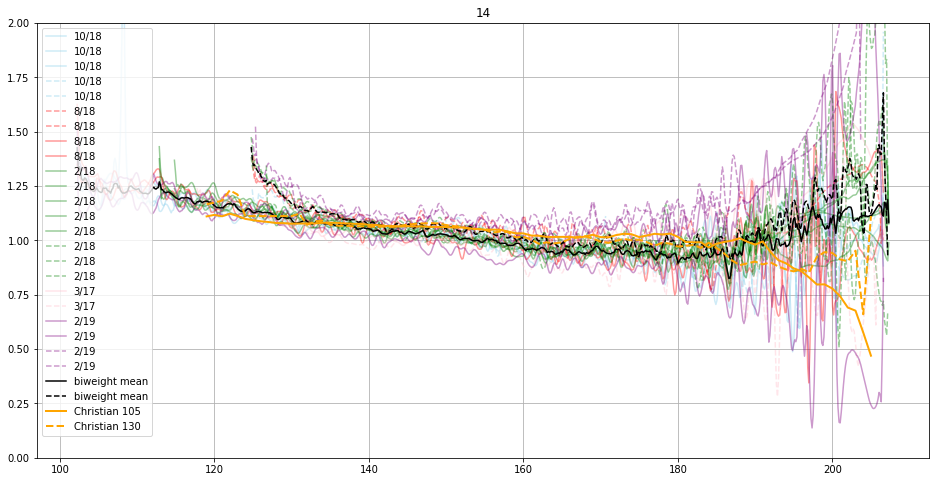

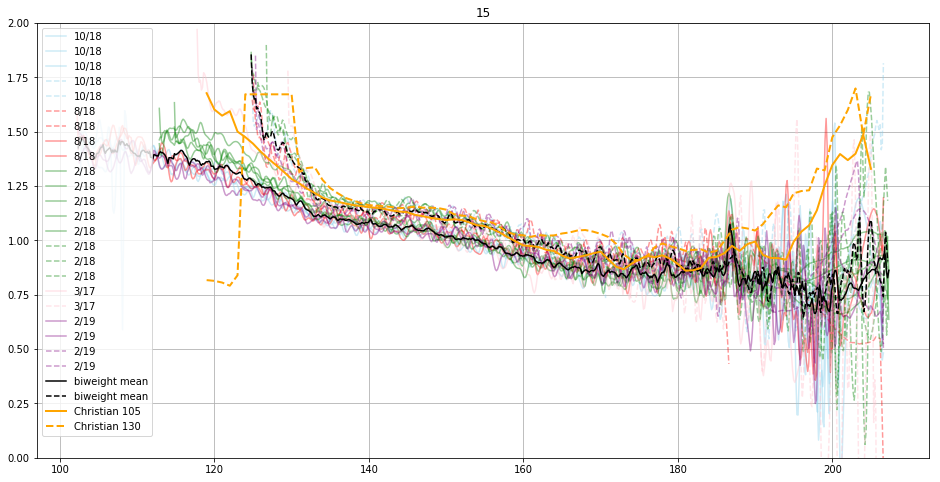

...

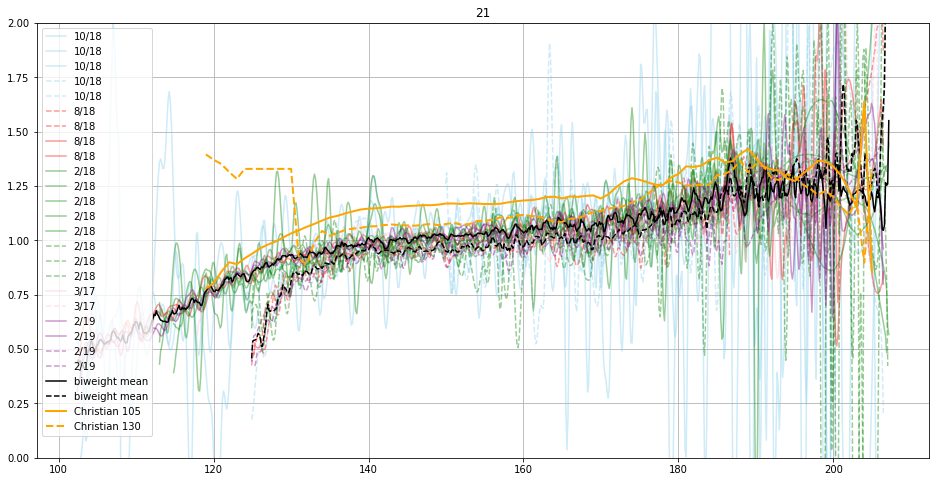

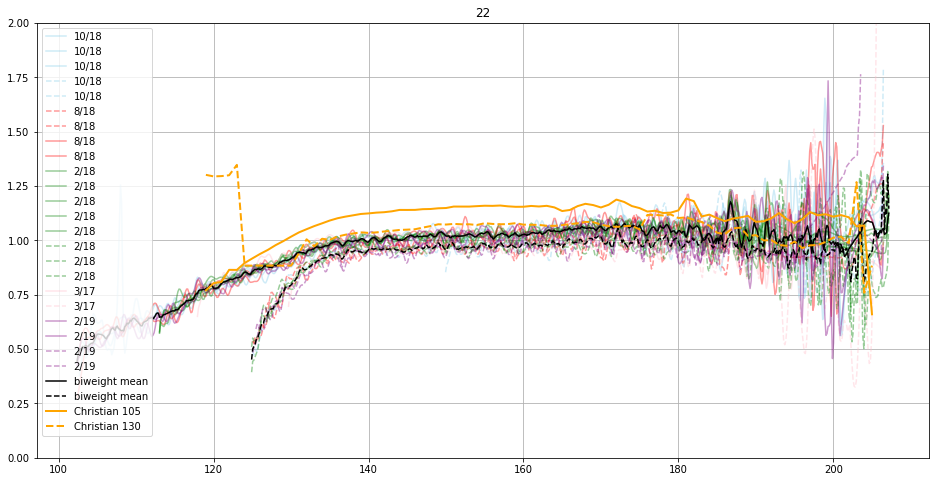

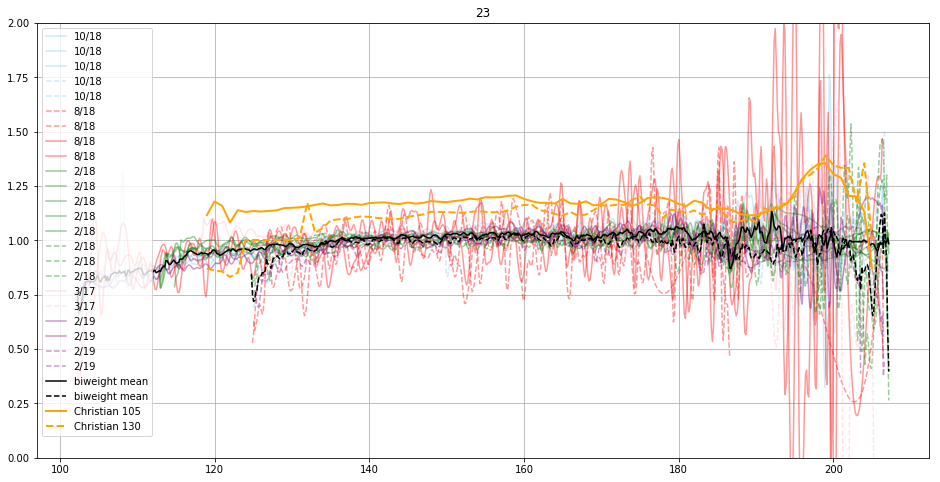

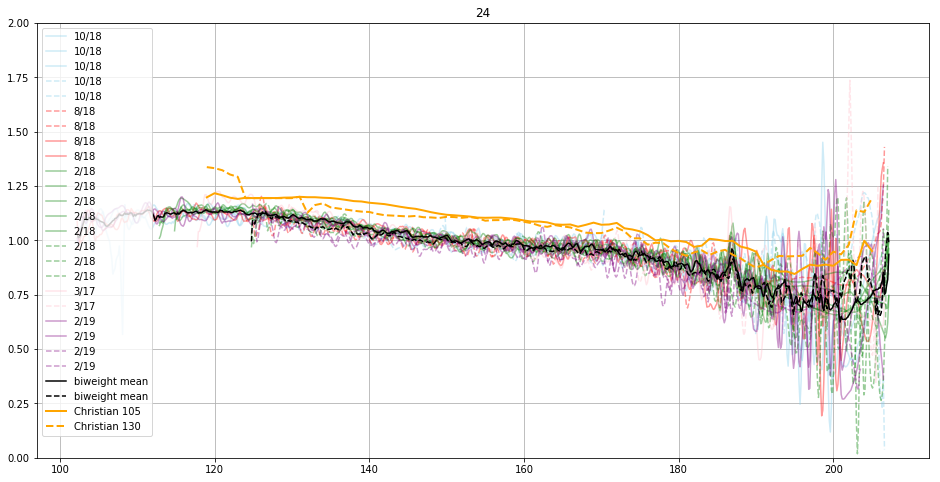

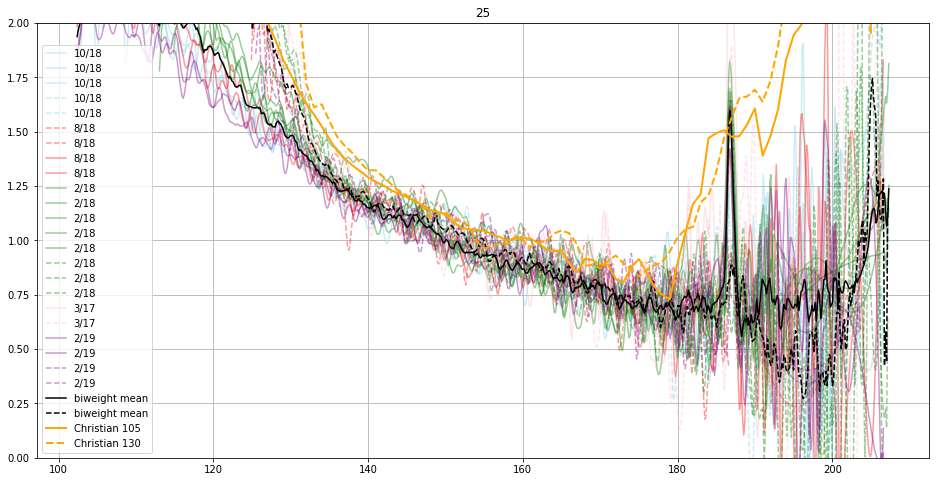

In [5]:
from fifipy.stats import biweightLocation

mask = [1,2,3,5,6,7,8,10,11,12,13,15,16,17,18,20,21,22,23]
spaxelSpectralFlatA = []
spaxelSpectralFlatB = []
for ispax in range(25):
    fig,ax = plt.subplots(figsize=(16,8))
    specA = []
    specB = []
    for w, s, d, dic in zip(waves, spatspectra, dates, dichroics):
        meds = biweightLocation(s[mask,:], axis = 0)
        if d == '10/18':
            color='skyblue'
            ss = s1
        elif d == '8/18':
            color='red'
            ss = s2
        elif d == '2/18':
            color='green'
            ss = s3
        elif d == '3/17':
            color='pink'
            ss = s4
        elif d == '2/19':
            color='purple'
            ss = s5
        else:
            color='black'
        if dic == 105:
            line = '-'
        else:
            line = '--'
        if dic == 105:
            specA.append(s[ispax,:]/meds/ss[ispax])
        else:
            specB.append(s[ispax,:]/meds/ss[ispax])
        ax.plot(w, s[ispax,:]/meds/ss[ispax], line, label = d, color=color,alpha=0.4)
    specA = np.array(specA)
    specB = np.array(specB)
    ssf = biweightLocation(specA, axis=0)
    spaxelSpectralFlatA.append(ssf)
    ax.plot(w, ssf, color='black',label='biweight mean')
    ssf = biweightLocation(specB, axis=0)
    spaxelSpectralFlatB.append(ssf)
    ax.plot(w, ssf, '--', color='black',label='biweight mean')
    ax.plot(wch, ff105[:,ispax]/s4[ispax],color='orange',label='Christian 105',linewidth=2)
    ax.plot(wch, ff130[:,ispax]/s4[ispax],'--',color='orange',label='Christian 130',linewidth=2)

    ax.legend()
    ax.set_title(str(ispax + 1))
    ax.set_ylim([0,2])
    ax.grid()
    plt.show()


## Step 3

Correcting the original spectra with spaxel spectral flats, recompute median spectra per spaxel,
and compute the spectral flats per spexel.

At the end, we can merge the two components or leave them separated.
In the future, we should have the possibility of adding a 5x5 real spatial flat 
which can be derived from sky or moon measurements.

In [6]:
# Copy the spectra
corrSpectra = spectra.copy()

# Apply the corrections spaxelSpectralFlat
w = waves[0]
for s, d in zip(corrSpectra, dichroics):
    # Choice of flat
    if d == 105:
        sflat = spaxelSpectralFlatA
    else:
        sflat = spaxelSpectralFlatB
    # Interpolation & flat
    for i, sf in enumerate(sflat):
        for j in range(16):
            s[i*16+j,:] /= sf

# Recompute spat spectra using the corrected spectra
spatspectra = []
for spectrum in corrSpectra:
    spatspectrum = computeMedianSpatialSpectra(spectrum)
    spatspectra.append(spatspectrum)
spatspectra = np.array(spatspectra)

In [7]:
# Check on spatspectra and update si (spatial flats)
w = waves[0]
i1 = dates == '10/18'
i2 = dates == '8/18'
i3 = dates == '2/18'
i4 = dates == '3/17'
i5 = dates == '2/19'
for ispax in range(25):
    med = []
    for ss, date in zip(spatspectra, dates):
        smed = biweightLocation(ss, axis=0)
        if date == '10/18':
            si = s1
        elif date == '8/18':
            si = s2
        elif date == '2/18':
            si = s3
        elif date == '3/17':
            si = s4
        elif date == '2/19':
            si = s5
        med.append(biweightLocation(ss[ispax,:]/smed/si[ispax]))
    med = np.array(med)
    if Test:
        print('Spaxel ', ispax+1)
    for ii, si in zip([i1,i2,i3,i4,i5],[s1,s2,s3,s4,s5]):
        mi = biweightLocation(med[ii])
        si[ispax] *= mi
        if Test: 
            print(mi)
    if Test:
        fig,ax = plt.subplots(figsize=(16,8))
        for ss, date in zip(spatspectra, dates):
            smed = biweightLocation(ss, axis=0)
            if date == '10/18':
                si = s1
            elif date == '8/18':
                si = s2
            elif date == '2/18':
                si = s3
            elif date == '3/17':
                si = s4
            elif date == '2/19':
                si = s5
            ax.plot(w, ss[ispax,:]/smed/si[ispax])
        ax.set_title('spaxel '+ str(ispax))
        ax.grid()
        ax.set_ylim(0,2)
        plt.show()

In [8]:
# TEST
%matplotlib inline
from fifipy.spectra import computeFlatRed
if Test:
    wdario = np.arange(105,205,0.2)
    fdario = np.ones((np.size(wdario),25,16))
    ispax = 12
    ispex = 7
    fig,ax = plt.subplots(figsize=(16,8))
    w = waves[0]
    for i in range(len(dichroics)):
        flats = computeFlatRed(waves,corrSpectra,spatspectra,ispax,ispex,delta=0.4)
        for s,ss,d in zip(corrSpectra, spatspectra, dichroics):
            if d == 105:
                color = 'blue'
            else:
                color = 'red'
            ax.plot(w,s[ispax*16+ispex]/ss[ispax],'.',markersize=0.2,color=color,linewidth=0.5)
    ax.plot(wch, f105[:,ispax,ispex],color='skyblue',label='Christian 105',linewidth=2)
    ax.plot(wch, f130[:,ispax,ispex],color='orange',label='Christian 130',linewidth=2)
    if flats is not None:
        flat, eflat = flats
        f = flat(wdario)
        ef = eflat(wdario)
        ax.plot(wdario,f,color='green',label='My flat ['+str(ispax+1)+','+str(ispex+1)+']',linewidth=3.)
        ax.plot(wdario,f+3*ef,color='green',linewidth=2.)
        ax.plot(wdario,f-3*ef,color='green',linewidth=2.)
        fdario[:,ispax,ispex] = flat(wdario)
    ax.set_xlim([105,207])
    ax.set_ylim([0.5,2.1])
    ax.legend()
    plt.show()

/Users/dfadda/Python/fifipy/fifipy/spectra.py:100: RuntimeWarning: invalid value encountered in less
  m = (fi < minflat) | (fi > maxflat)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:100: RuntimeWarning: invalid value encountered in greater
  m = (fi < minflat) | (fi > maxflat)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:105: RuntimeWarning: invalid value encountered in greater
  m = np.abs(fi-med) > 3*mad


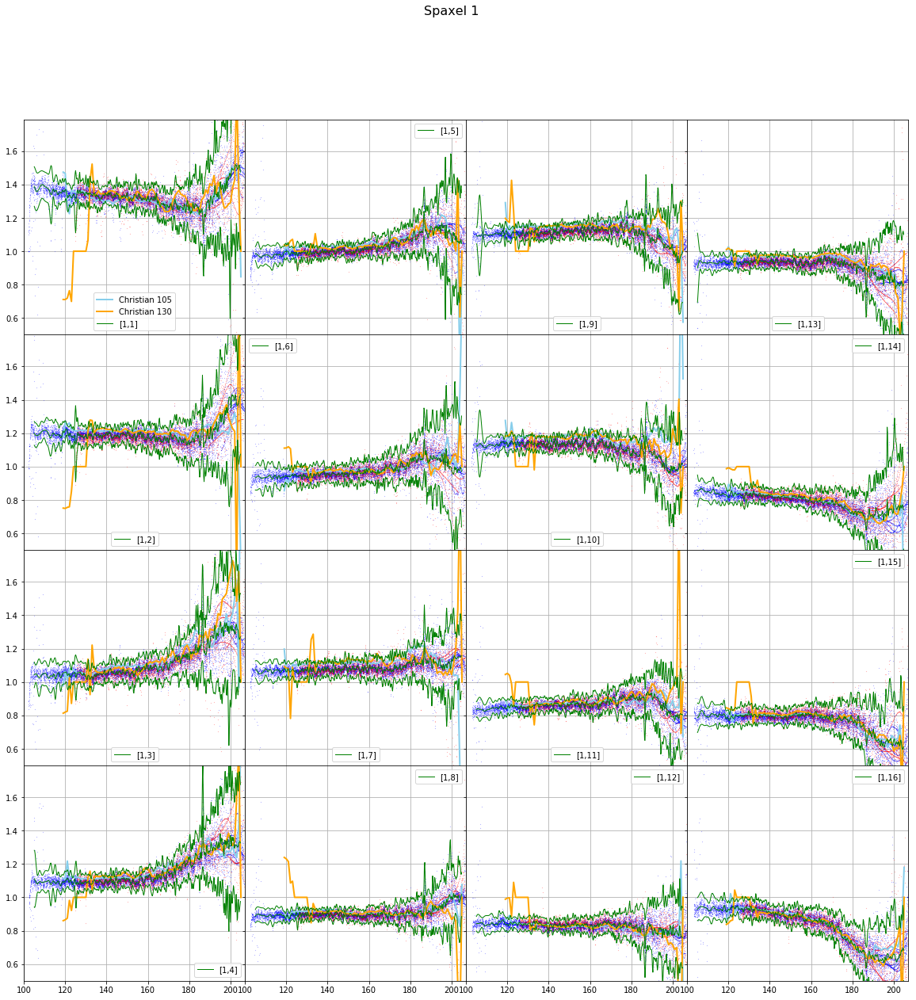

/Users/dfadda/anaconda3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:959: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanmedian1d, axis, a, overwrite_input)
/Users/dfadda/Python/fifipy/fifipy/spectra.py:117: RuntimeWarning: invalid value encountered in less
  mask = np.abs(med - mf) < 10*mad
No handles with labels found to put in legend.


There are no arrays to concatenate


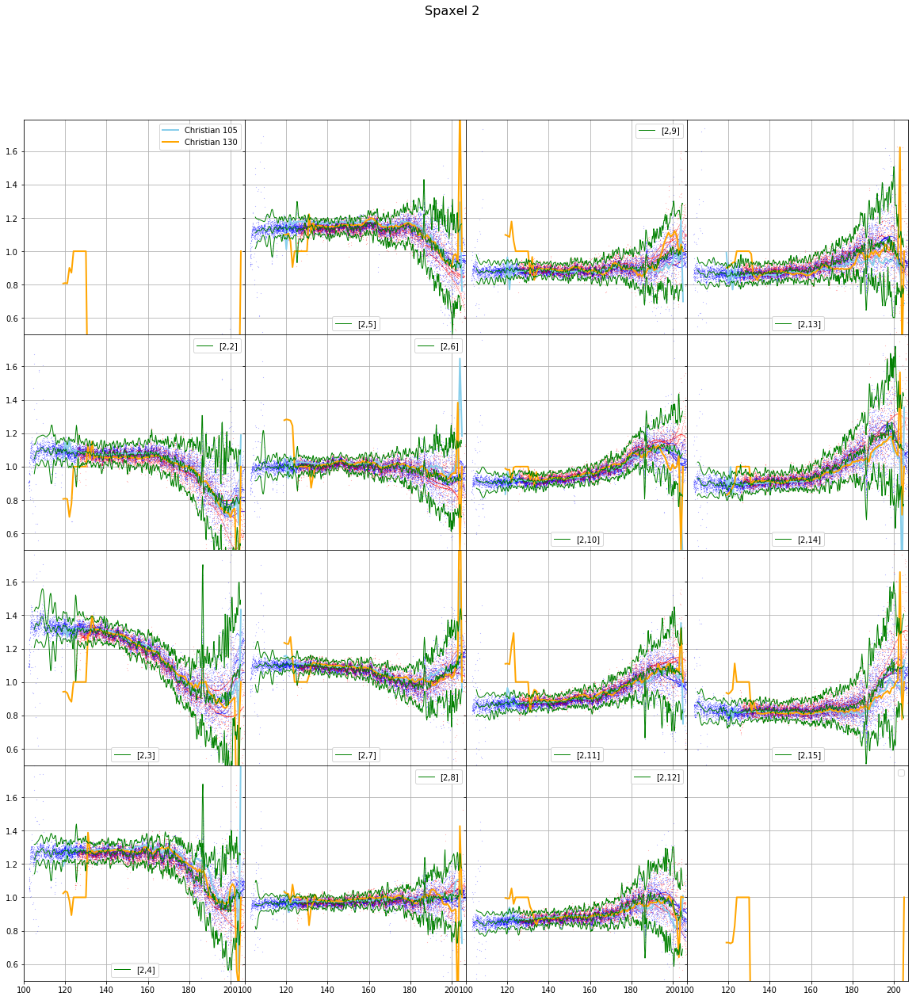

No handles with labels found to put in legend.


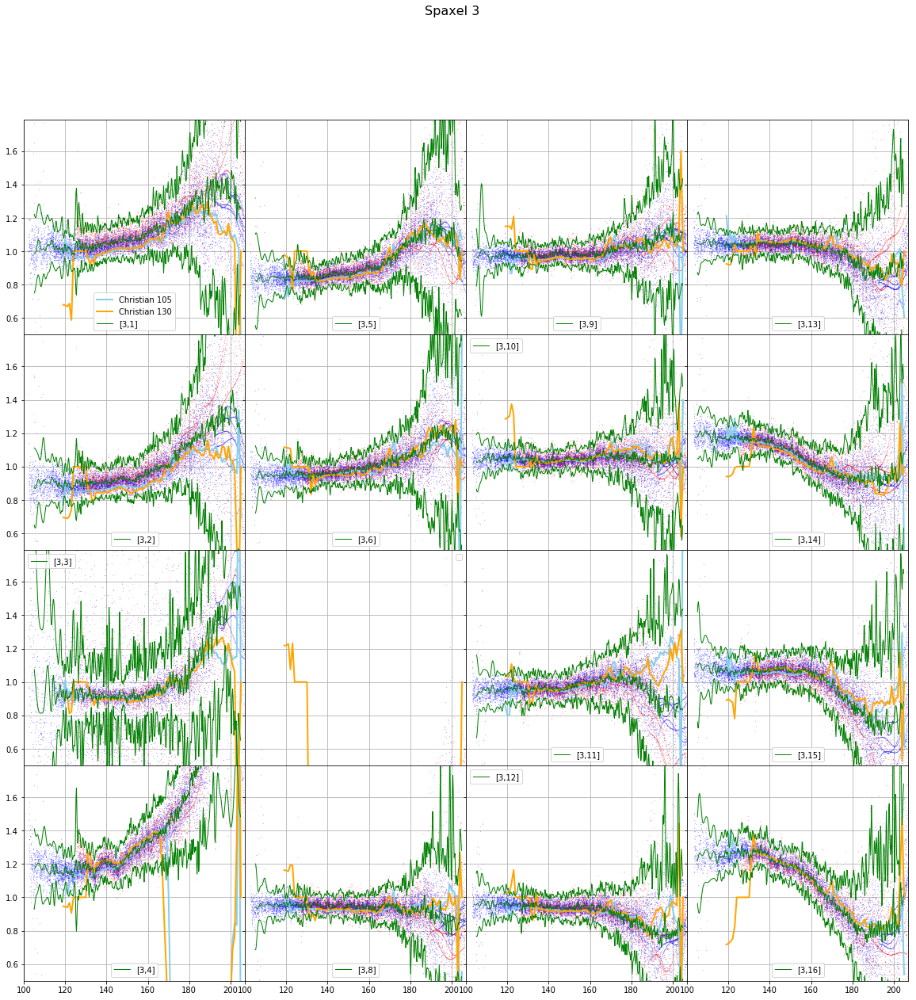

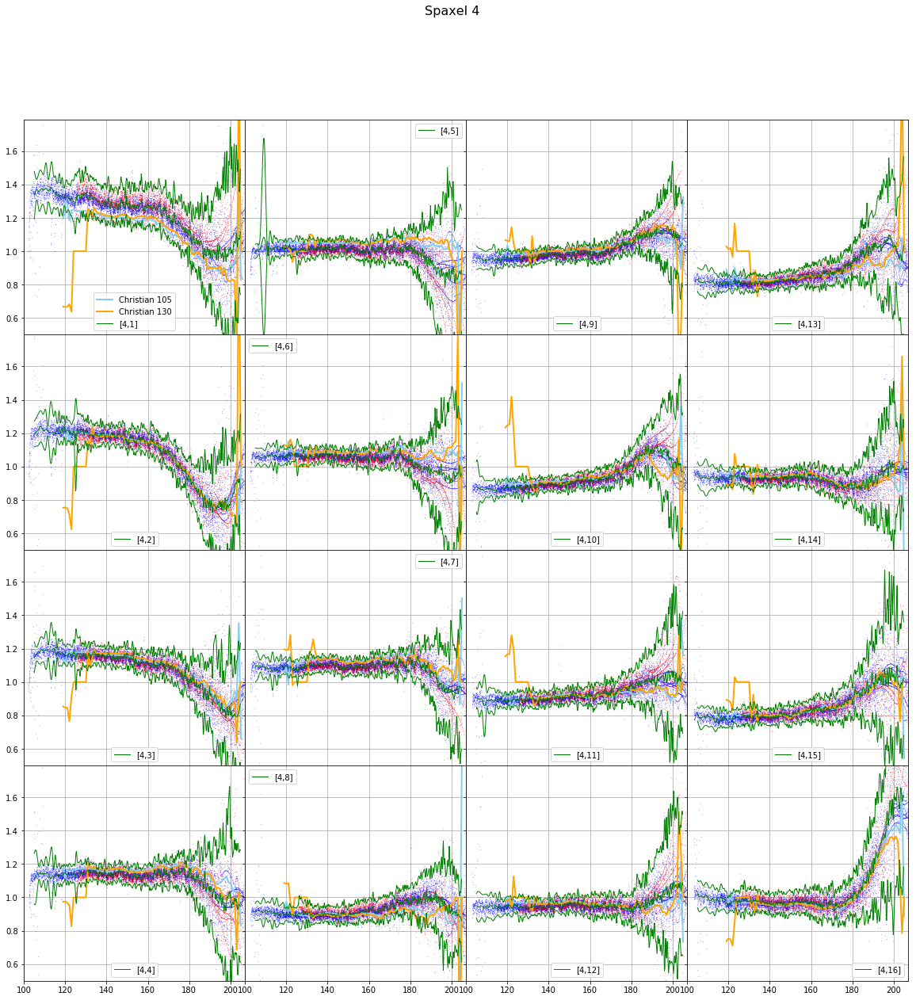

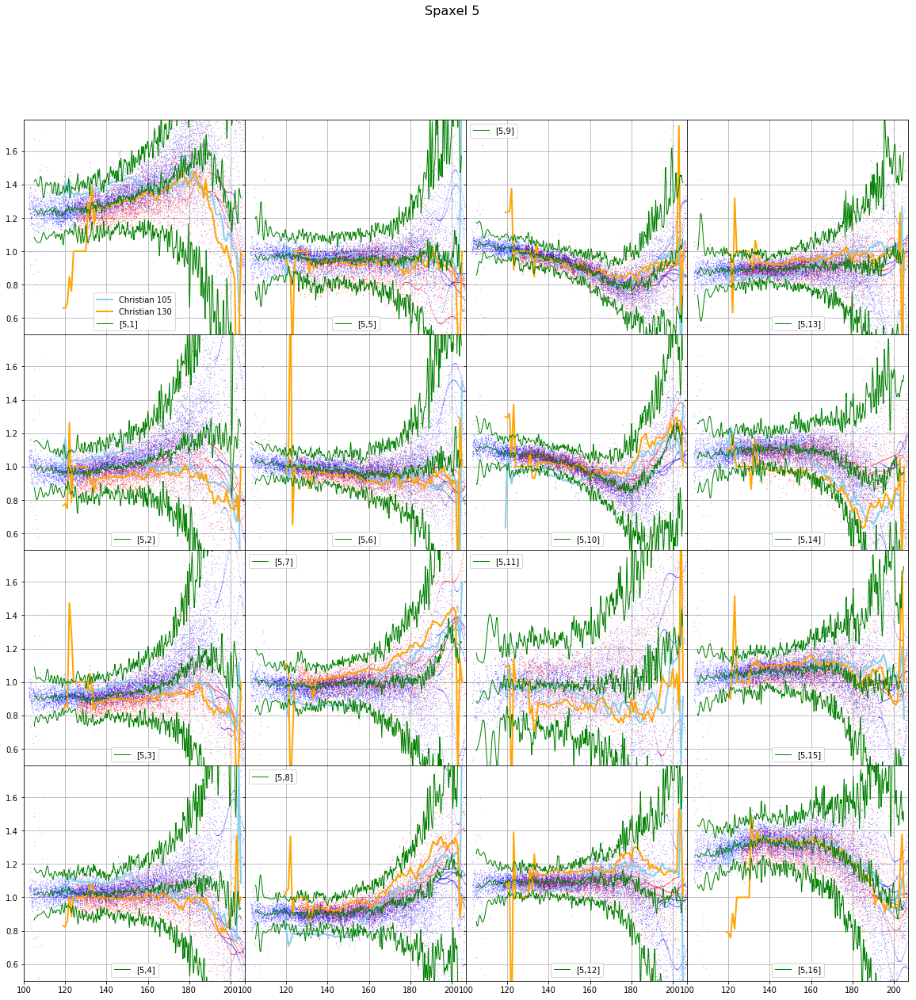

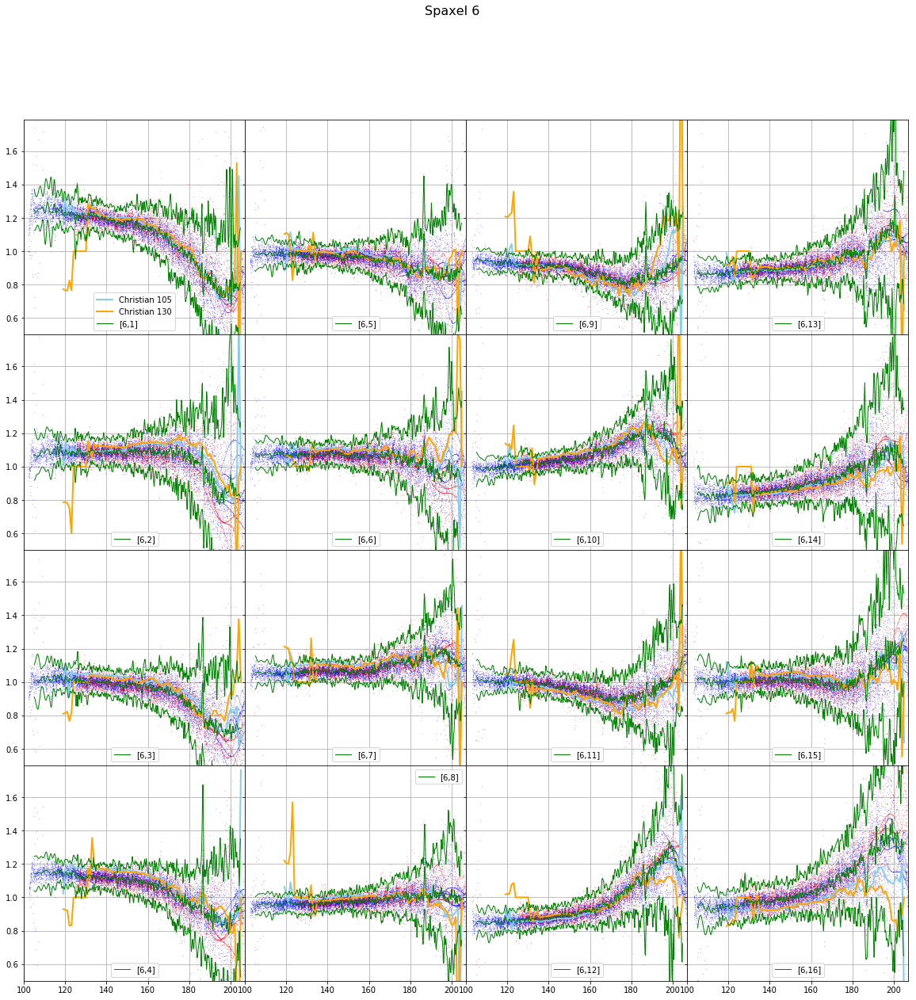

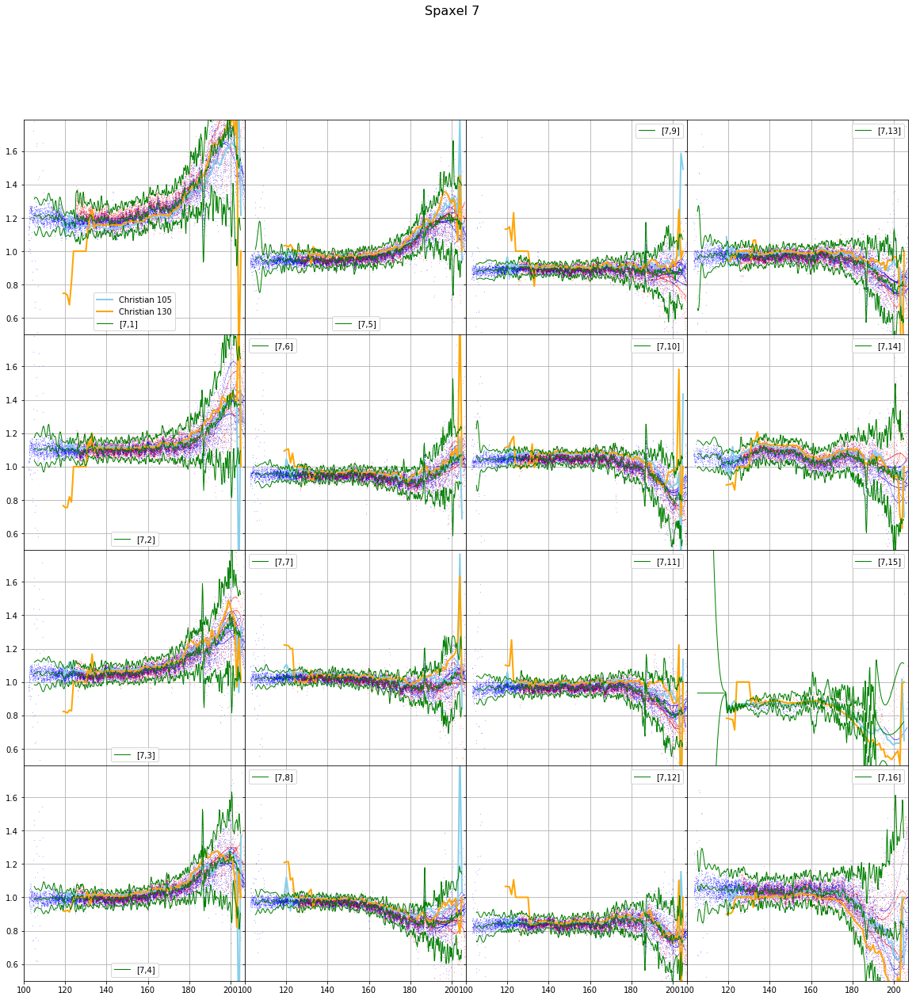

...

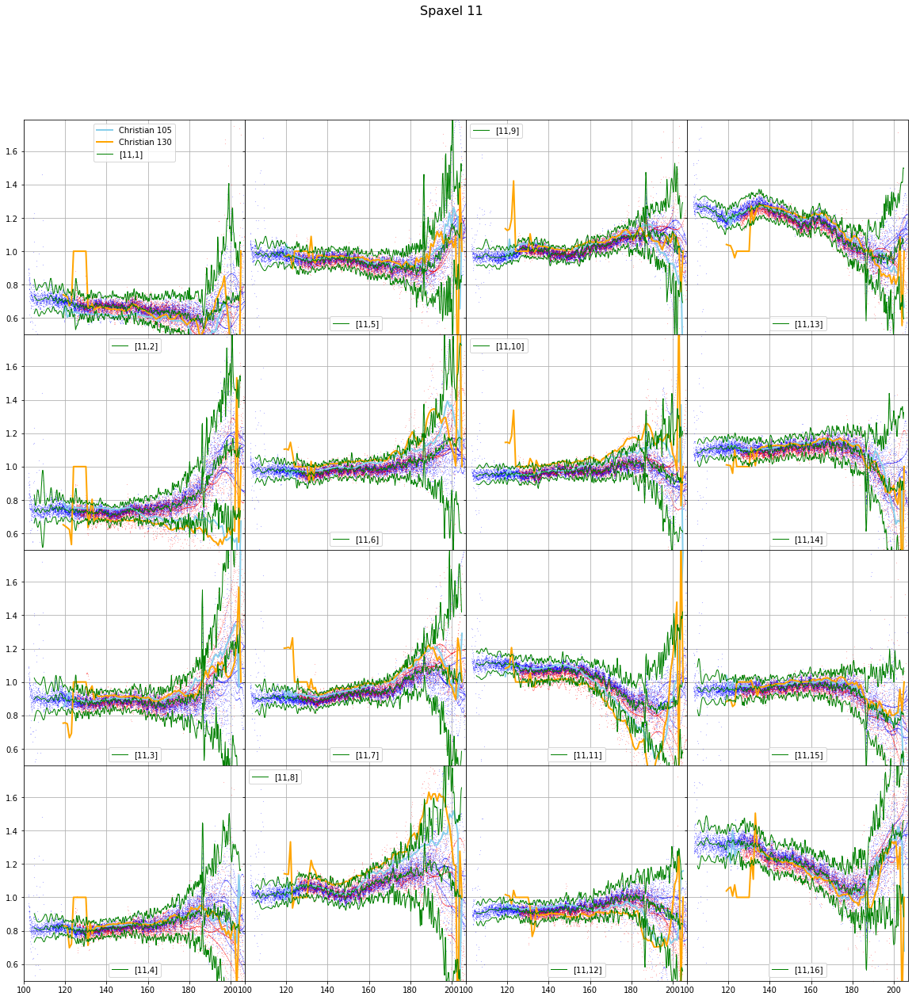

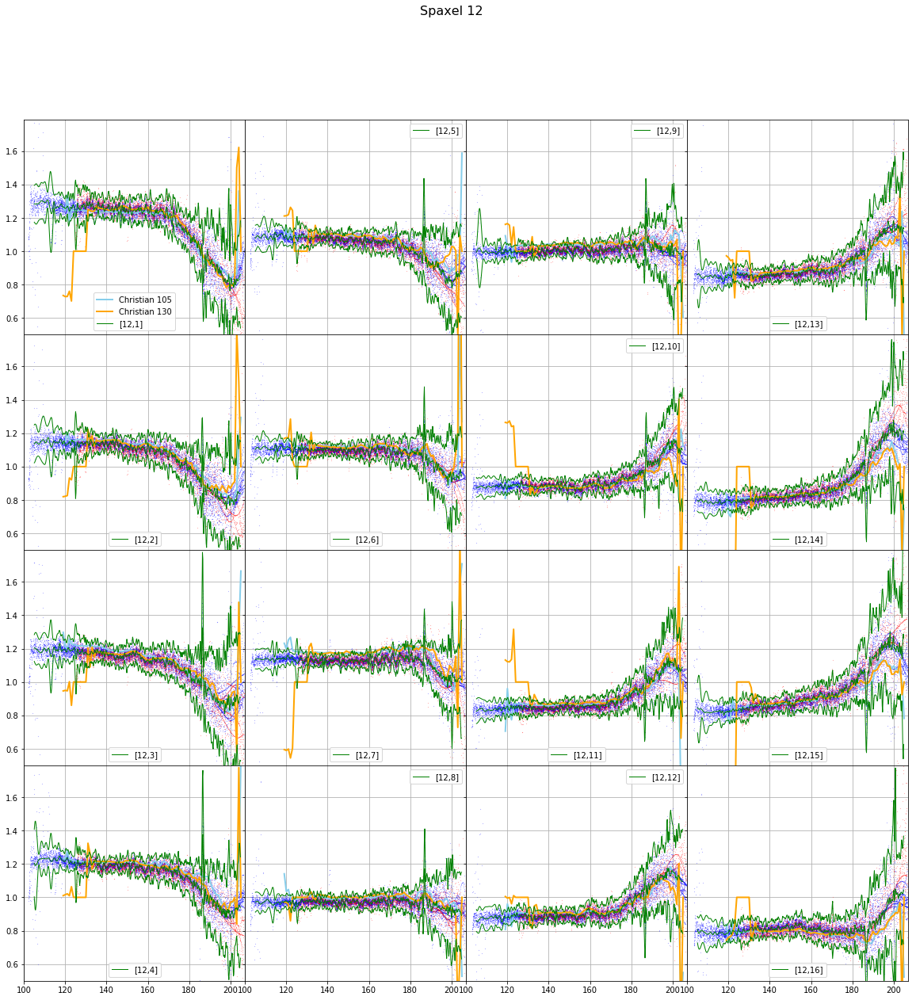

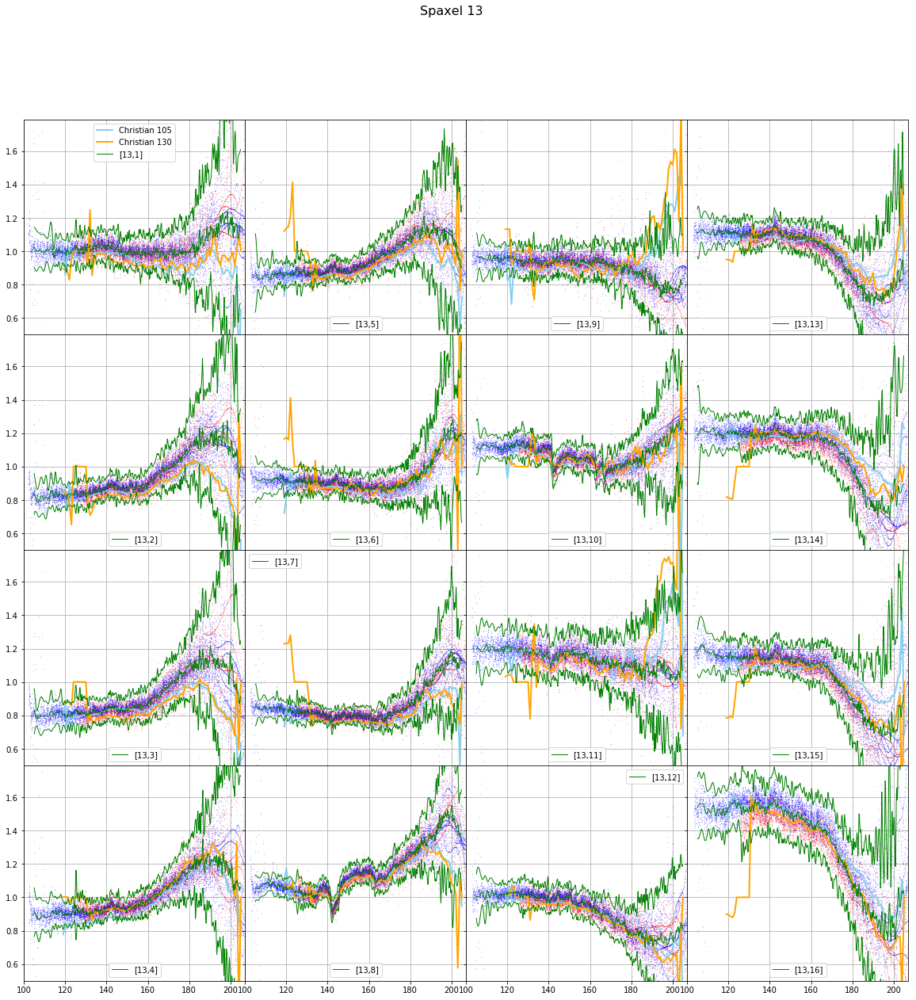

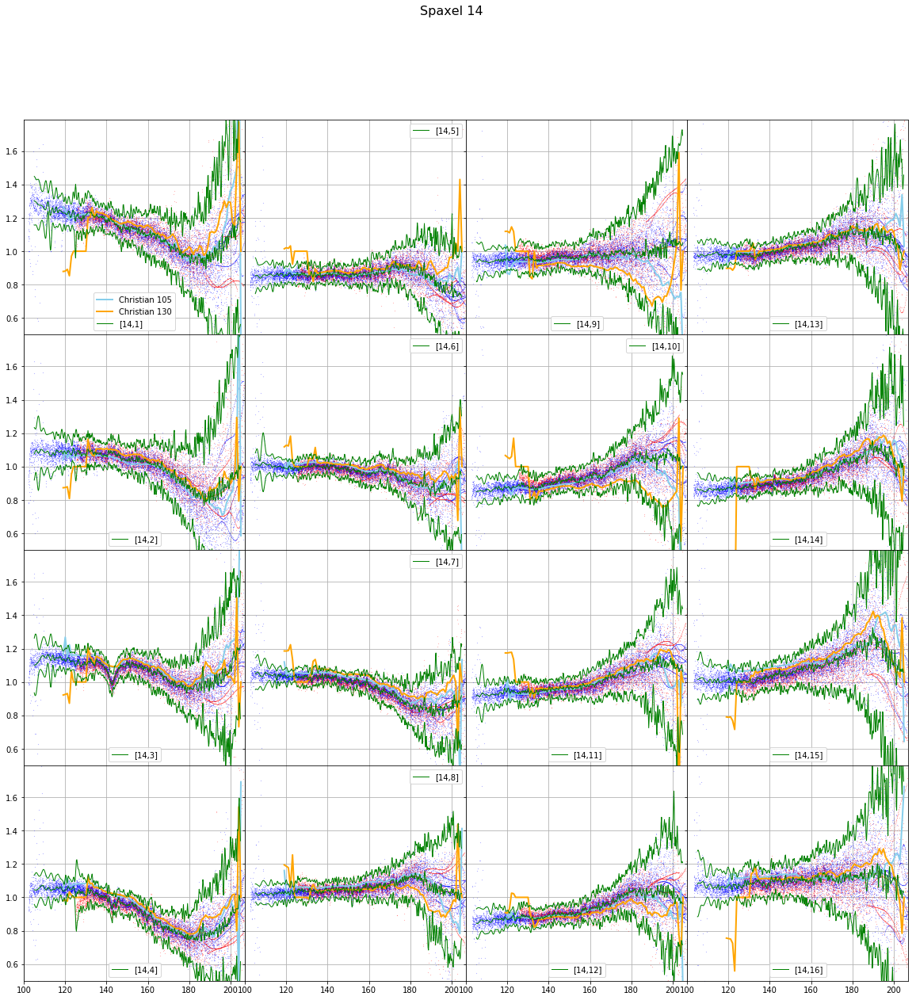

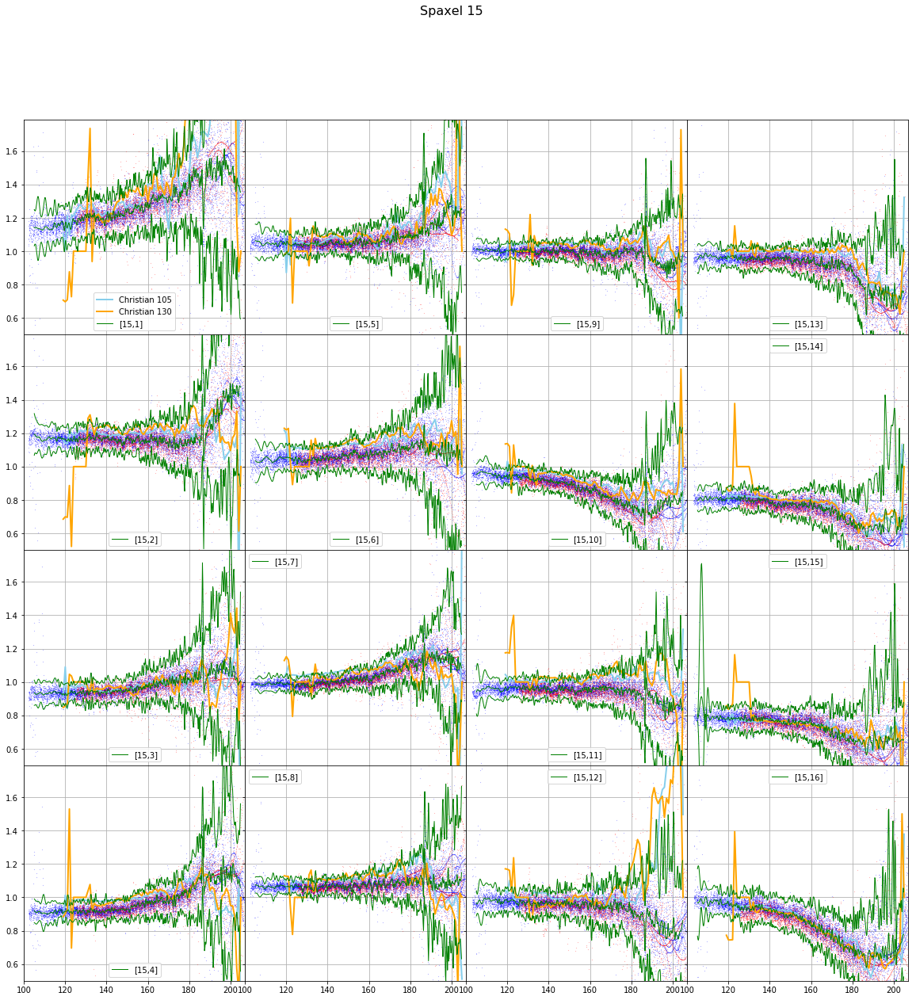

No handles with labels found to put in legend.


There are no arrays to concatenate


No handles with labels found to put in legend.


There are no arrays to concatenate


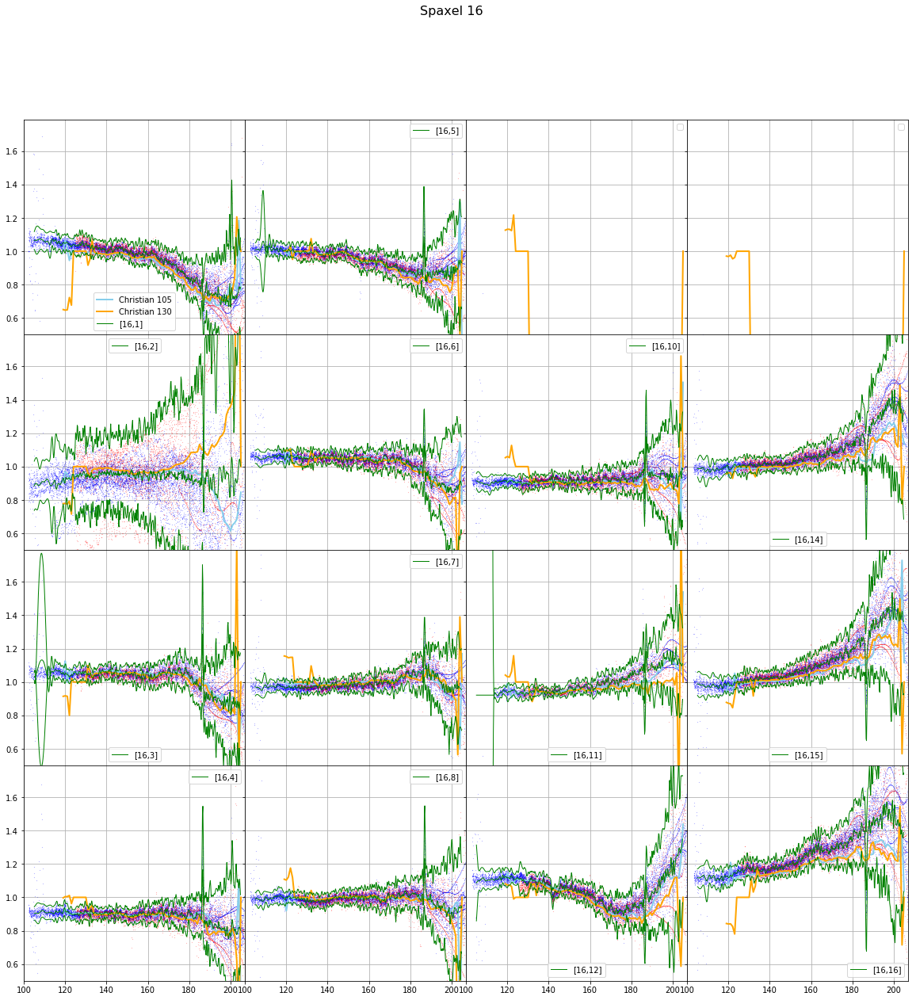

No handles with labels found to put in legend.


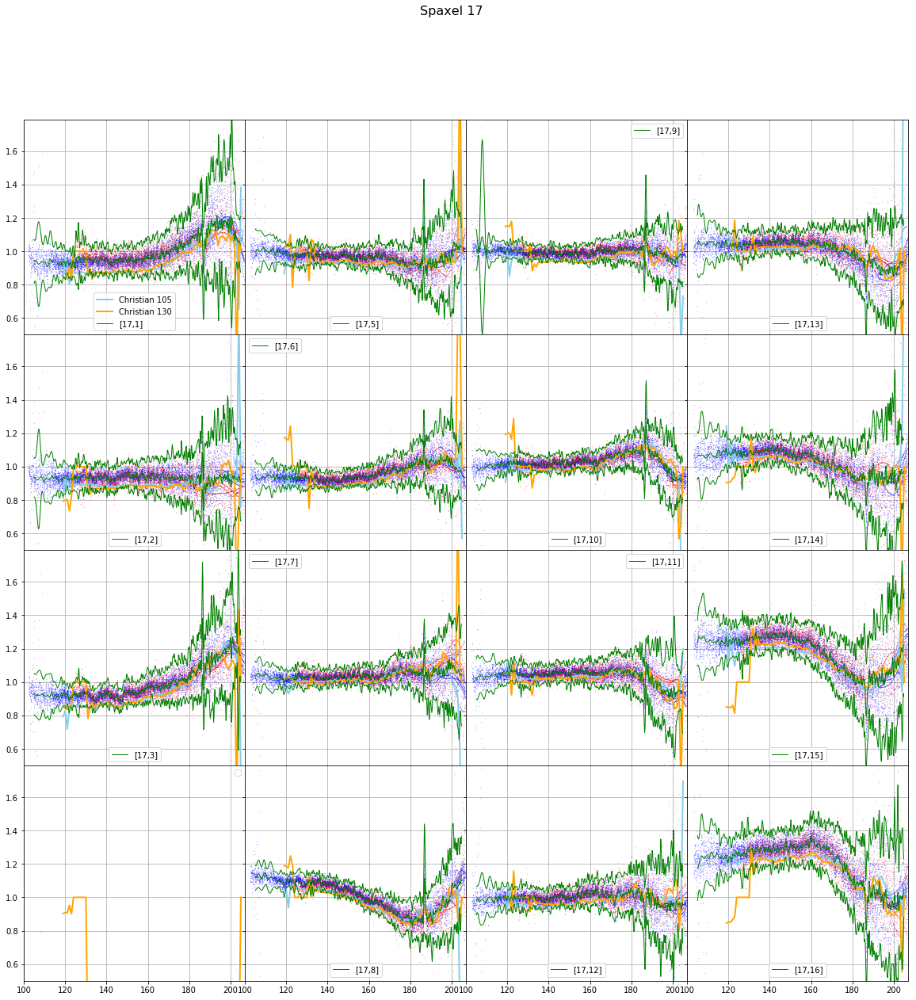

No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


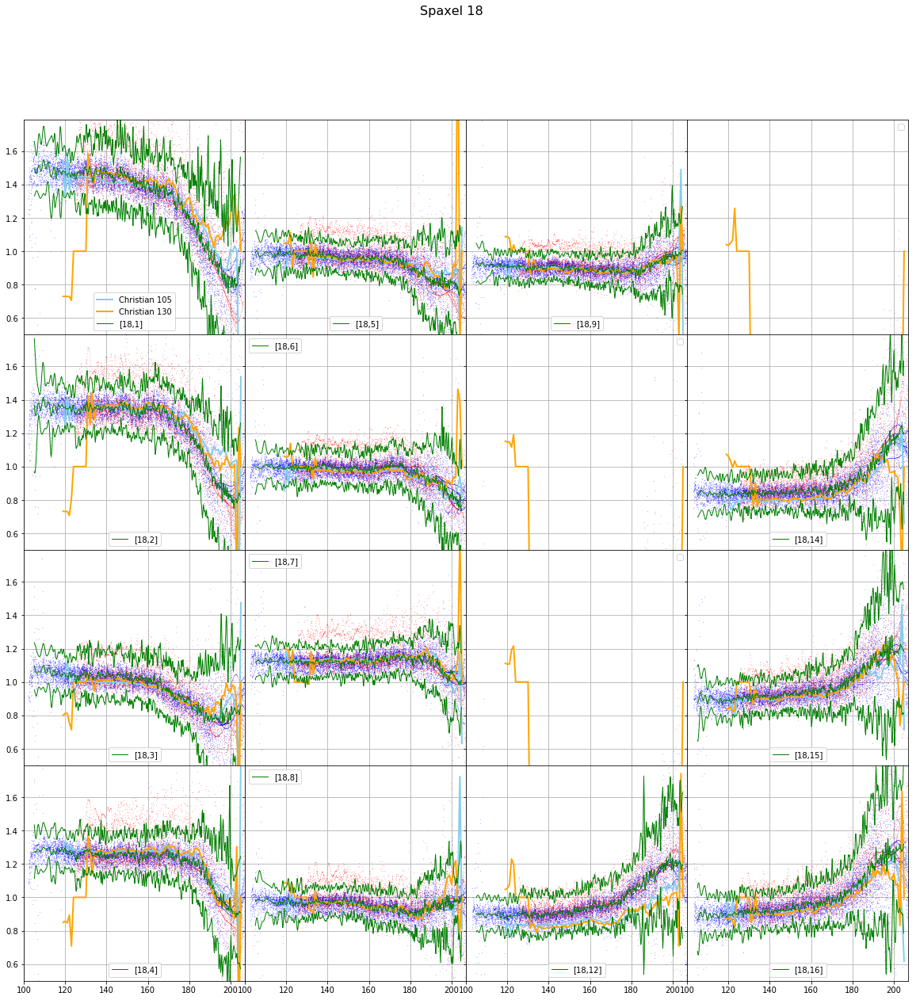

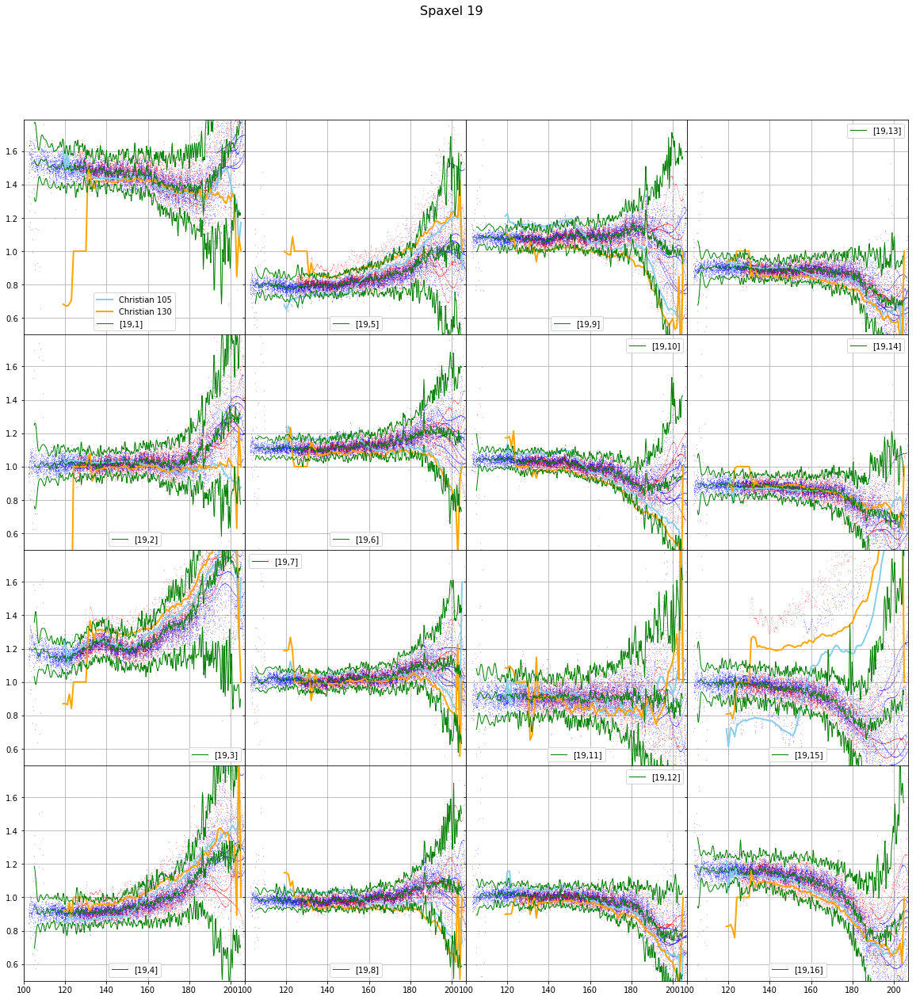

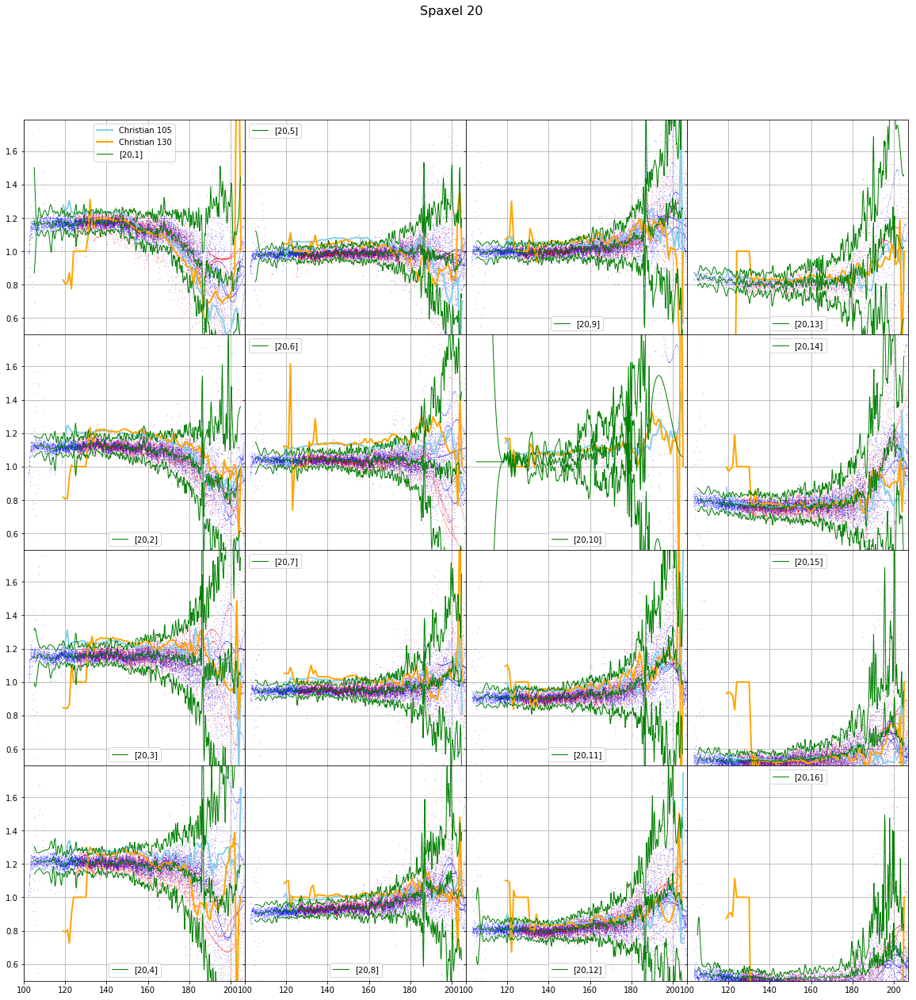

No handles with labels found to put in legend.


There are no arrays to concatenate


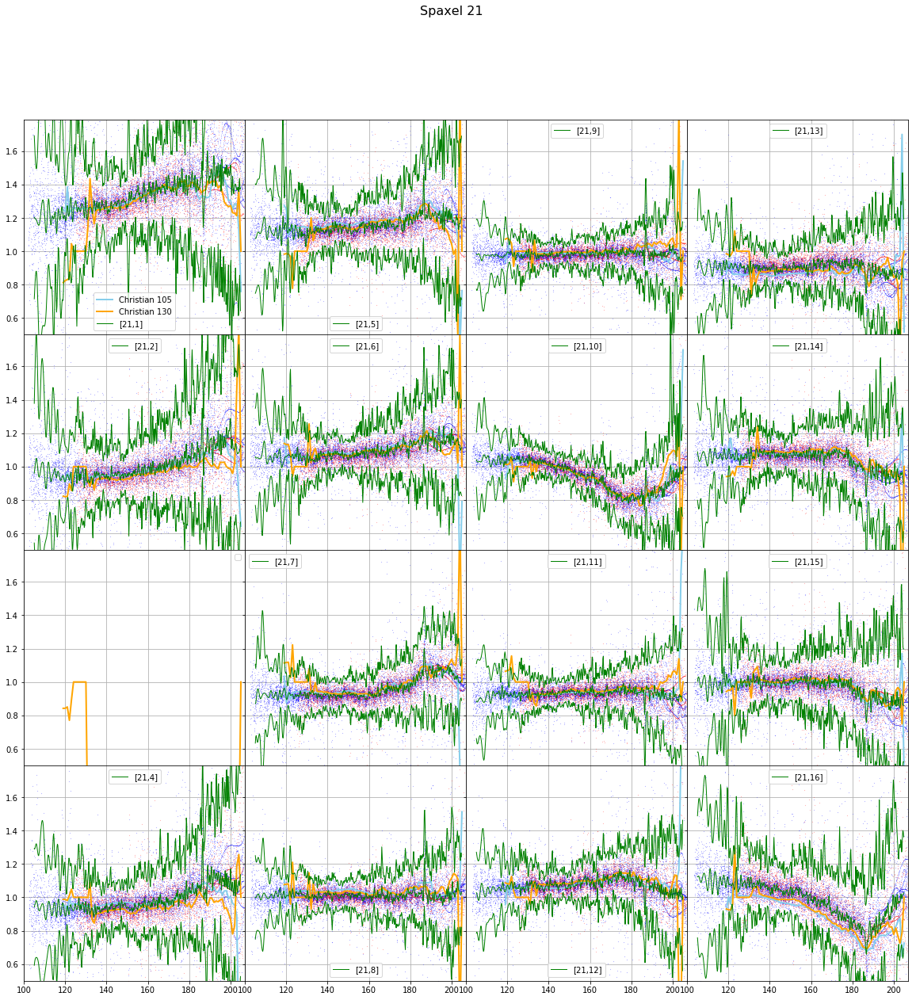

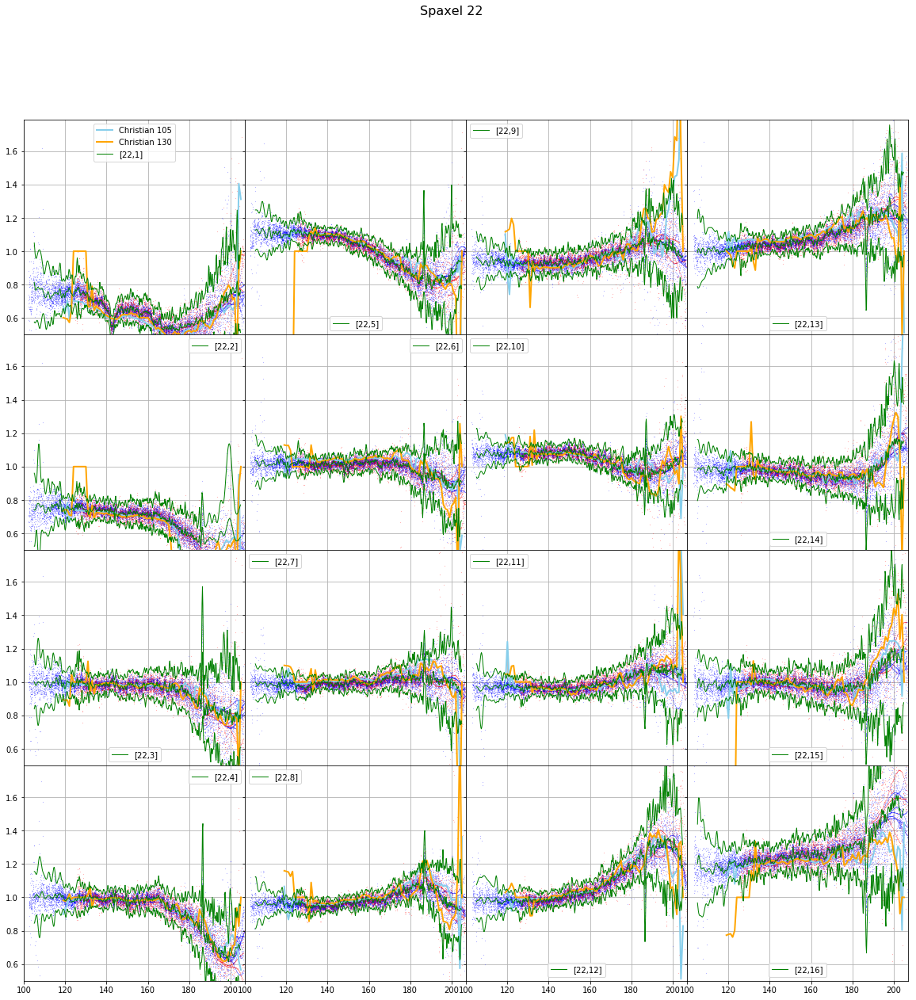

No handles with labels found to put in legend.


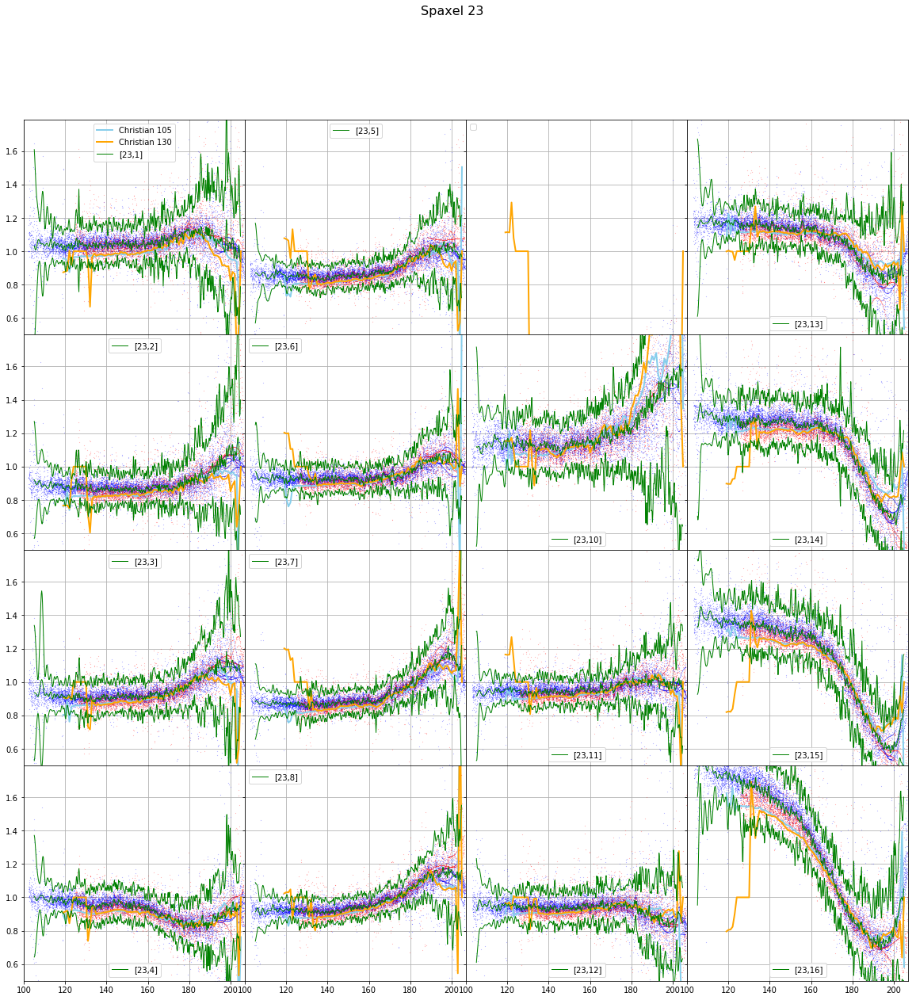

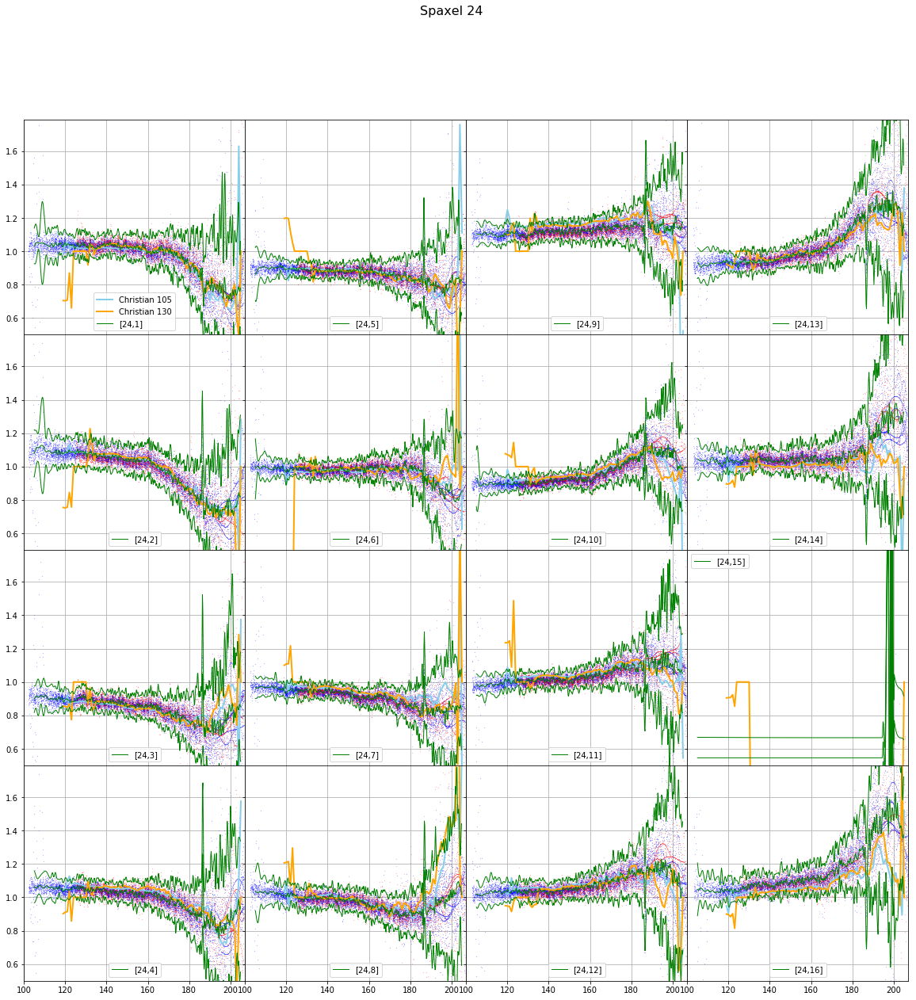

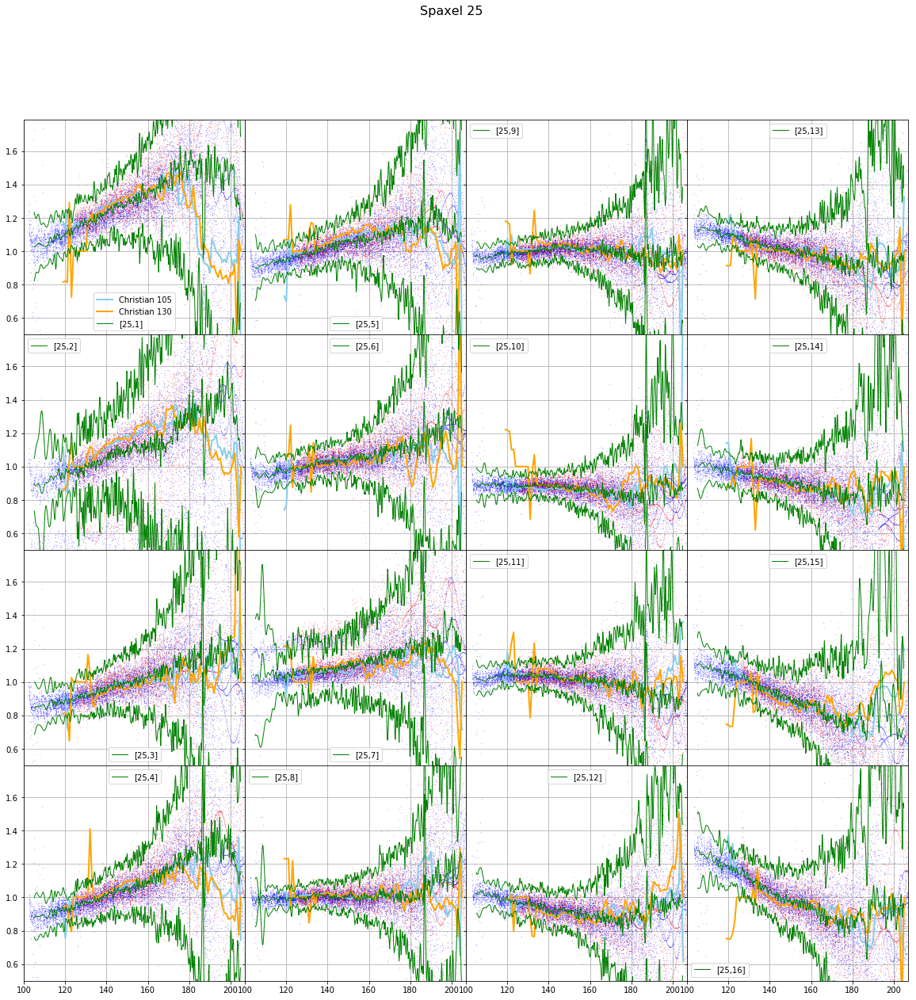

badpixels: 
(2, 1)
(2, 16)
(3, 7)
(16, 9)
(16, 13)
(17, 4)
(18, 10)
(18, 11)
(18, 13)
(21, 3)
(23, 9)


In [9]:
%matplotlib inline
from fifipy.spectra import computeFlatRed
wdario = np.arange(105,205,0.2)
fdario = np.ones((np.size(wdario),25,16))
efdario = np.ones((np.size(wdario),25,16))
badpix = []
w = waves[0]
for ispax in range(25):
    # Flats
    fig,axes = plt.subplots(4,4,figsize=(20,20), sharex=True, sharey=True)
    for ispex in range(16):
        flats = computeFlatRed(waves, corrSpectra, spatspectra, ispax, ispex, delta=0.4)
        ax = axes[ispex % 4, ispex // 4]
        for s,ss,d in zip(corrSpectra, spatspectra, dichroics):
            if d == 105:
                color = 'blue'
            else:
                color = 'red'
            ax.plot(w,s[ispax*16+ispex]/ss[ispax],'.',markersize=0.2,color=color,linewidth=0.5)
        if ispex == 0:
            ax.plot(wch, f105[:,ispax,ispex],color='skyblue',label='Christian 105',linewidth=2)
            ax.plot(wch, f130[:,ispax,ispex],color='orange',label='Christian 130',linewidth=2)
        else:
            ax.plot(wch, f105[:,ispax,ispex],color='skyblue', linewidth=2)
            ax.plot(wch, f130[:,ispax,ispex],color='orange', linewidth=2)
        if flats is not None:
            flat,eflat=flats
            f = flat(wdario)
            ef = eflat(wdario)
            ax.plot(wdario,f,color='green',label='['+str(ispax+1)+','+str(ispex+1)+']',linewidth=1.)
            ax.plot(wdario,f+3*ef,color='green',linewidth=1.)
            ax.plot(wdario,f-3*ef,color='green',linewidth=1.)
            fdario[:,ispax,ispex] = f
            efdario[:,ispax,ispex] = ef
        else:
            badpix.append((ispax+1, ispex+1))
        ax.set_xlim([100,207])
        ax.set_ylim([0.5,1.79])
        ax.grid()
        ax.legend()
    plt.subplots_adjust(wspace=0, hspace=0)
    fig.suptitle('Spaxel '+str(ispax + 1), fontsize=16)
    #fig.subplots_adjust(top=0.88)
    plt.show()
    
print("badpixels: ")
for bad in badpix:
    print(bad)

In [10]:
# Blend the two flats (spaxel and spexels)
w = waves[0]

# For D105 we use the entire wavelength range (105-205)
w105 = wdario
spexelSpectralFlatR1D105 = fdario.copy()
efR1D105 = efdario.copy()
print(np.shape(spexelSpectralFlatR1D105))
for ispax, sft in enumerate(spaxelSpectralFlatA):
    sft_ = np.interp(w105, w, sft)
    for ispex in range(16):
        spexelSpectralFlatR1D105[:,ispax,ispex] *= sft_

# For D130 we need only the range 125-205        
idx, = np.where( (wdario >= 125) & (wdario <= 205))
w130 = wdario[idx]
efR1D130 = efdario[idx,:,:].copy()
spexelSpectralFlatR1D130 = fdario[idx,:,:].copy()
print(np.shape(spexelSpectralFlatR1D130))
for ispax, sft in enumerate(spaxelSpectralFlatB):
    sft_ = np.interp(w130, w, sft)
    for ispex in range(16):
        spexelSpectralFlatR1D130[:,ispax,ispex] *= sft_


(500, 25, 16)
(400, 25, 16)


In [11]:
# Save the flats
import os
caldir = '/Users/dfadda/sofia/FIFI-LS/SpectralFlats/'

from fifipy.io import saveSpecFlats
saveSpecFlats(w105, spexelSpectralFlatR1D105, efR1D105,'RED', 1, 105, caldir+'spectralFlatsR1D105.fits')
saveSpecFlats(w130, spexelSpectralFlatR1D130, efR1D130,'RED', 1, 130, caldir+'spectralFlatsR1D130.fits')

from fifipy.io import saveSpatFlats           
d1 = '20181001'
d2 = '20180801'
d3 = '20180201'
d4 = '20170301'
d5 = '20190201'
ss = np.array([s4,s3,s2,s1,s5])
dd = np.array([20180101,
                20180701,
                20180901,
                20190101,
                99999999
               ], dtype = int) #limit date to apply the flat
saveSpatFlats(ss, dd, 'RED', caldir+'spatialFlatR.fits')

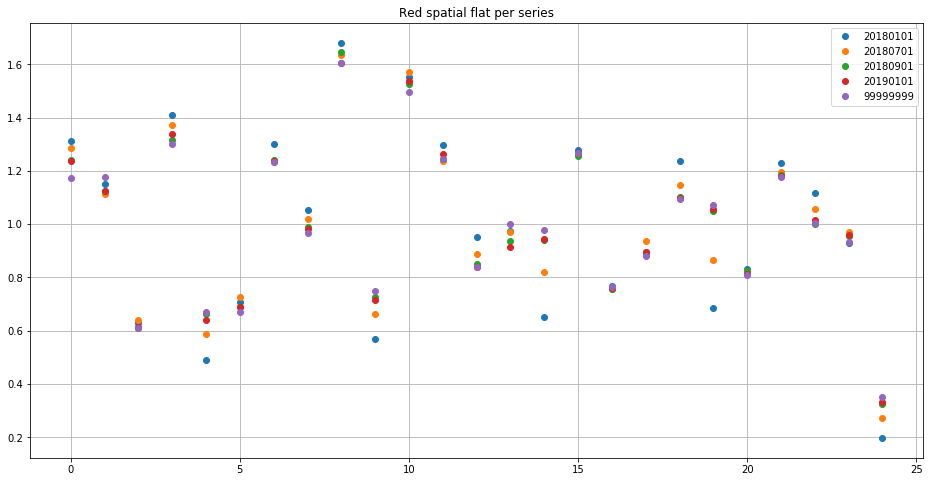

In [12]:
# Comparison of pixel illumination (constant spatial flats)
from astropy.io import fits
hdl = fits.open('/Users/dfadda/sofia/FIFI-LS/SpectralFlats/spatialFlatR.fits')
#hdl.info()
dates = hdl['DATES'].data
flats = hdl['SPATFLAT'].data
hdl.close()

#print(dates)
fig,ax = plt.subplots(figsize=(16,8))
for f, date in zip(flats, dates):
    ax.plot(f,'o',label=str(date))
ax.grid()
ax.set_title('Red spatial flat per series')
ax.legend()
plt.show()

In [13]:
if Test:
    # Spatial illumination
    spaflat2d = np.reshape(s1,(5,5))
    plt.imshow(spaflat2d, cmap='gray', origin='lower')
    plt.colorbar()
    plt.show()
    # Errors
    ef = np.nanmedian(efdario/fdario, axis=0)
    plt.imshow(ef, cmap='gray_r', origin='lower')
    plt.colorbar()
    plt.clim(0,.08)
    plt.show()